<a href="https://colab.research.google.com/github/AYA0HASSAN/RAVIR-Segmentation/blob/main/RAVIRSegmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size = 5>Libraries</font><br>
<font size = 2 color = 'gray'>just run that cell</font>

In [1]:
!pip install torch torchvision torchaudio -f https://download.pytorch.org/whl/cu111/torch_stable.html

Looking in links: https://download.pytorch.org/whl/cu111/torch_stable.html


In [2]:
!pip install -U albumentations

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [4]:
import torch
from torch import nn
import os
import cv2
import pandas as pd
from os import path
import torchvision
from sklearn.model_selection import train_test_split
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from typing import Sequence
from torch.utils.data import Dataset
import albumentations as A
import torch.nn.init as I
import gc
import albumentations as A

import numbers
import random
import numpy as np
import torch.optim as optim
from matplotlib import pyplot as plt
import glob
from tqdm import tqdm

In [5]:
torch.version.cuda

'12.1'

In [6]:
torch.cuda.get_device_name()

'Tesla T4'

In [7]:
torch.backends.cudnn.enabled = True

In [8]:
def get_train_augs():
    return A.Compose([
        # A.Resize(512, 512),
        # A.RandomCrop(height=128, width=128),
        A.HorizontalFlip(p=0.05),
        A.VerticalFlip(p=0.05),
        A.Rotate(limit=30, p=0.5),  # Random rotation up to 30 degrees
        A.RandomBrightnessContrast(p=0.5),
        A.RandomGamma(p=0.2),
        A.Blur(blur_limit=(3, 7), p=0.2),  # Random blur
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=30, p=0.5),
        A.HorizontalFlip(p=0.05)
    ], p=1.0)

def get_valid_augs():
    return A.Compose([
        # A.Resize(512, 512),
    ], p=1.0)


In [9]:
class SegmentationDataset(Dataset):
    def __init__(self, root, train, augmentations=None, augmentation_times=3):
        self.root = root
        self.train = train
        self.augmentations = augmentations
        self.augmentation_times = augmentation_times if train else 1

        self.images = list(sorted(os.listdir(os.path.join(root, "training_images"))))
        self.masks = list(sorted(os.listdir(os.path.join(root, "training_masks"))))

        # Split data into train and test sets
        self.images_train, self.images_test, self.masks_train, self.masks_test = train_test_split(
            self.images, self.masks, test_size=0.2, random_state=42)

    def __len__(self):
        if self.train:
            return len(self.images_train) * self.augmentation_times
        else:
            return len(self.images_test)

    def __getitem__(self, idx):
        # Adjust index for augmented samples
        original_idx = idx // self.augmentation_times

        if self.train:
            imagePath = os.path.join(self.root, "training_images/", self.images_train[original_idx])
            maskPath = os.path.join(self.root, "training_masks", self.masks_train[original_idx])
        else:
            imagePath = os.path.join(self.root, "training_images", self.images_test[original_idx])
            maskPath = os.path.join(self.root, "training_masks", self.masks_test[original_idx])

        # Load image and mask
        image = cv2.imread(imagePath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(maskPath, cv2.IMREAD_GRAYSCALE)

        # Create masks
        veins_mask = (mask == 256).astype(np.float32)
        arteries_mask = (mask == 128).astype(np.float32)
        background_mask = (mask == 0).astype(np.float32)
        mask_onehot = np.stack([background_mask,veins_mask, arteries_mask], axis=-1)

        # Apply augmentations
        if self.augmentations:
            augmented = self.augmentations(image=image, mask=mask_onehot)
            image = augmented['image']
            mask_onehot = augmented['mask']

        # Transform to tensor and normalize
        image = np.transpose(image, (2, 0, 1)).astype(np.float32)
        mask_onehot = np.transpose(mask_onehot, (2, 0, 1)).astype(np.float32)
        image = torch.Tensor(image) / 255.0
        mask_onehot = torch.Tensor(mask_onehot)

        return image, mask_onehot

In [10]:
BATCH_SIZE = 2
root = "/content/gdrive/MyDrive/Deep Learning Labs/RAVIR Dataset/RAVIR Dataset/train"

In [11]:
trainDataset = SegmentationDataset(root,train = True,augmentations = get_train_augs())
testDataset = SegmentationDataset(root,train = False,augmentations = get_valid_augs())

In [12]:
len(testDataset)

5

In [13]:
trainDataLoader = DataLoader(trainDataset , batch_size =BATCH_SIZE , shuffle =True )
testDataLoader = DataLoader(testDataset , batch_size =BATCH_SIZE  )

In [14]:

# Function to convert torch tensor to numpy array and denormalize
def tensor_to_numpy(tensor):
    return tensor.cpu().detach().numpy()

# Function to plot images, masks, and predictions
def plot(images, masks):
    num_samples = len(images)

    for i in range(num_samples):
        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(tensor_to_numpy(images[i]).transpose(1, 2, 0), cmap='gray')
        plt.title('Image')

        plt.subplot(1, 3, 2)
        plt.imshow(tensor_to_numpy(masks[i]).transpose(1, 2, 0), cmap='gray')
        plt.title('Ground Truth Mask')

        plt.show()


  0%|          | 0/27 [00:00<?, ?it/s]

torch.Size([2, 3, 768, 768])
torch.Size([2, 3, 768, 768])


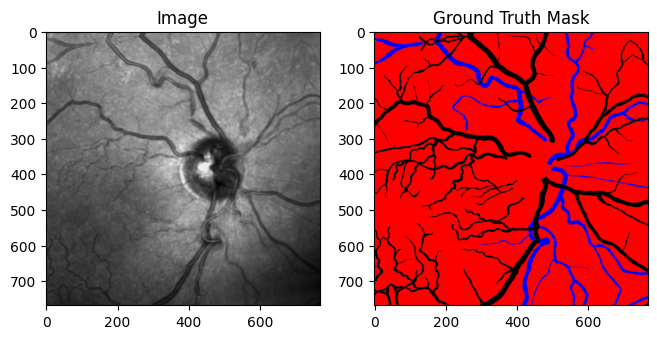

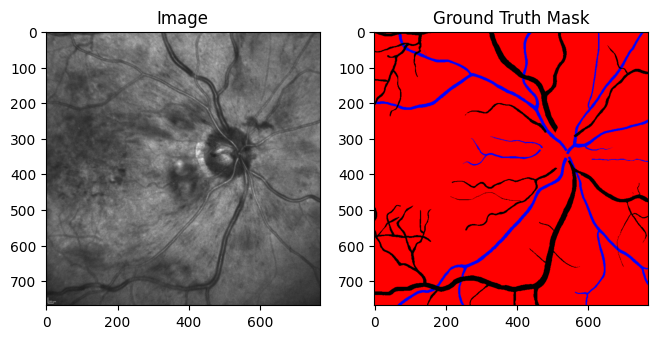

  0%|          | 0/27 [00:03<?, ?it/s]


In [15]:
for image,mask in tqdm(trainDataLoader):
  print(image.shape)
  print(mask.shape)
  plot(image,mask)

  break

In [16]:
len(trainDataLoader)

27

### Losses

In [17]:
class DiceLoss(nn.Module):
    def __init__(self):
        super(DiceLoss, self).__init__()

    def forward(self, input, target):
        smooth = 1.0

        iflat = input.view(-1)
        tflat = target.view(-1)
        intersection = (iflat * tflat).sum()

        return 1 - ((2.0 * intersection + smooth) / (iflat.sum() + tflat.sum() + smooth))


In [18]:
class IoULoss(nn.Module):
    def __init__(self, smooth=1.0):
        super(IoULoss, self).__init__()
        self.smooth = smooth

    def forward(self, predicted, target):
        intersection = torch.sum(predicted * target)
        union = torch.sum(predicted) + torch.sum(target) - intersection

        iou = (intersection + self.smooth) / (union + self.smooth)

        loss = 1.0 - iou

        return loss

In [19]:
class MAPELoss(nn.Module):
    def __init__(self):
        super(MAPELoss, self).__init__()

    def forward(self, y_pred, y_true):
        mask = (y_true != 0).float()
        absolute_percentage_error = torch.abs((y_true - y_pred) / (y_true + 1e-8))

        # Apply the mask to exclude cases where the true value is zero
        masked_absolute_percentage_error = absolute_percentage_error * mask

        # Calculate the mean over non-zero values
        mape = torch.sum(masked_absolute_percentage_error) / torch.sum(mask)

        return mape

In [20]:
class MeanIoU:
    def __init__(self, num_classes):
        self.num_classes = num_classes
        self.confusion_matrix = np.zeros((num_classes, num_classes), dtype=np.int64)

    def update(self, y_true, y_pred):
        # Convert to integer type
        y_true = y_true.astype(np.int64)
        y_pred = y_pred.astype(np.int64)

        # Flatten the 2D arrays to 1D
        y_true = y_true.flatten()
        y_pred = y_pred.flatten()

        # Update the confusion matrix
        self.confusion_matrix += np.bincount(self.num_classes * y_true + y_pred,
                                             minlength=self.num_classes**2).reshape(self.num_classes, self.num_classes)

    def reset(self):
        # Reset the confusion matrix
        self.confusion_matrix = np.zeros((self.num_classes, self.num_classes), dtype=np.int64)

    def calculate(self):
        # Calculate IoU for each class
        intersection = np.diag(self.confusion_matrix).astype(np.float64)
        union = (np.sum(self.confusion_matrix, axis=0) + np.sum(self.confusion_matrix, axis=1) - intersection).astype(np.float64)

        # Avoid division by zero
        union[union == 0] = 1.0

        # Calculate mean IoU
        iou = np.divide(intersection, union)
        mean_iou = np.mean(iou)

        return mean_iou


In [21]:
# Function to convert torch tensor to numpy array and denormalize
def tensor_to_numpy(tensor):
    return tensor.cpu().detach().numpy()

# Function to plot images, masks, and predictions
def plot_images(images, masks, predictions):
    num_samples = len(images)

    for i in range(num_samples):
        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(tensor_to_numpy(images[i]).transpose(1, 2, 0))
        plt.title('Image')

        plt.subplot(1, 3, 2)
        plt.imshow(tensor_to_numpy(masks[i]).transpose(1, 2, 0), cmap='gray')
        plt.title('Ground Truth Mask')

        plt.subplot(1, 3, 3)
        plt.imshow(tensor_to_numpy(predictions[i]).transpose(1, 2, 0), cmap='gray')
        plt.title('Model Prediction')

        plt.show()


### Unet Model

In [22]:
class doubleConvBlock(nn.Module):
    def __init__(self, in_channels, middle_channels, out_channels):
        super().__init__()
        self.relu = nn.ReLU(inplace=True)
        self.conv1 = nn.Conv2d(in_channels, middle_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(middle_channels)
        self.conv2 = nn.Conv2d(middle_channels, out_channels, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        return out


class UNet(nn.Module):
    def __init__(self, num_classes, input_channels=3, deep_supervision=False, **kwargs):
        super().__init__()

        nb_filter = [32, 64, 128, 256, 512]

        self.deep_supervision = deep_supervision

        self.pool = nn.MaxPool2d(2, 2)
        self.up = nn.Upsample(
            scale_factor=2, mode='bilinear', align_corners=True)

        self.conv0_0 = doubleConvBlock(input_channels, nb_filter[0], nb_filter[0])
        self.conv1_0 = doubleConvBlock(nb_filter[0], nb_filter[1], nb_filter[1])
        self.conv2_0 = doubleConvBlock(nb_filter[1], nb_filter[2], nb_filter[2])
        self.conv3_0 = doubleConvBlock(nb_filter[2], nb_filter[3], nb_filter[3])
        self.conv4_0 = doubleConvBlock(nb_filter[3], nb_filter[4], nb_filter[4])

        self.conv0_1 = doubleConvBlock(
            nb_filter[0]+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_1 = doubleConvBlock(
            nb_filter[1]+nb_filter[2], nb_filter[1], nb_filter[1])
        self.conv2_1 = doubleConvBlock(
            nb_filter[2]+nb_filter[3], nb_filter[2], nb_filter[2])
        self.conv3_1 = doubleConvBlock(
            nb_filter[3]+nb_filter[4], nb_filter[3], nb_filter[3])

        self.conv0_2 = doubleConvBlock(
            nb_filter[0]*2+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_2 = doubleConvBlock(
            nb_filter[1]*2+nb_filter[2], nb_filter[1], nb_filter[1])
        self.conv2_2 = doubleConvBlock(
            nb_filter[2]*2+nb_filter[3], nb_filter[2], nb_filter[2])

        self.conv0_3 = doubleConvBlock(
            nb_filter[0]*3+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_3 = doubleConvBlock(
            nb_filter[1]*3+nb_filter[2], nb_filter[1], nb_filter[1])

        self.conv0_4 = doubleConvBlock(
            nb_filter[0]*4+nb_filter[1], nb_filter[0], nb_filter[0])

        if self.deep_supervision:
            self.final1 = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)
            self.final2 = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)
            self.final3 = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)
            self.final4 = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)
        else:
            self.final = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)

    def forward(self, input):
        x0_0 = self.conv0_0(input)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up(x1_0)], 1))

        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up(x2_2)], 1))
        x0_4 = self.conv0_4(
            torch.cat([x0_0, x0_1, x0_2, x0_3, self.up(x1_3)], 1))

        if self.deep_supervision:
            output1 = self.final1(x0_1)
            output2 = self.final2(x0_2)
            output3 = self.final3(x0_3)
            output4 = self.final4(x0_4)
            return [output1, output2, output3, output4]

        else:
            output = nn.functional.sigmoid(self.final(x0_4))
            return output


In [23]:

torch.cuda.empty_cache()
gc.collect()

12838

In [24]:
print(torch.cuda.is_available())

True


In [25]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
dice = DiceLoss().to(device)
iou = IoULoss().to(device)
mIoU = MeanIoU(3)
mape  = MAPELoss().to(device)

cuda = True

model = UNet(3).to(device)
epoch_num = 150
criterion = torch.nn.BCELoss()
lr = 0.0001
param_dict = [
            {
                "params": model.parameters(),
                "lr": lr
            },
        ]
optimizer = torch.optim.AdamW(
        param_dict, lr=lr, weight_decay=1e-4)

100%|██████████| 27/27 [00:50<00:00,  1.87s/it]


Train Results
IOU Loss: 0.024968884885311127,IOU: 0.23019440925224874 , DICE Loss: 0.018832508474588394, MAPE Loss: 0.014241521246731281
Epoch 1/150, Loss: 0.5368584802857151


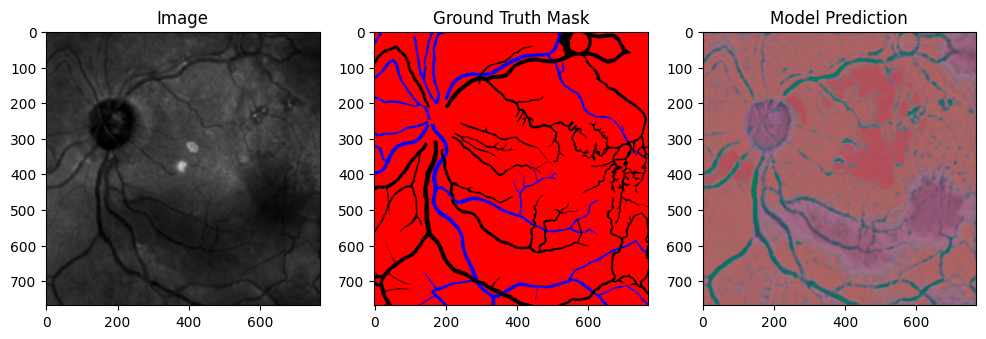

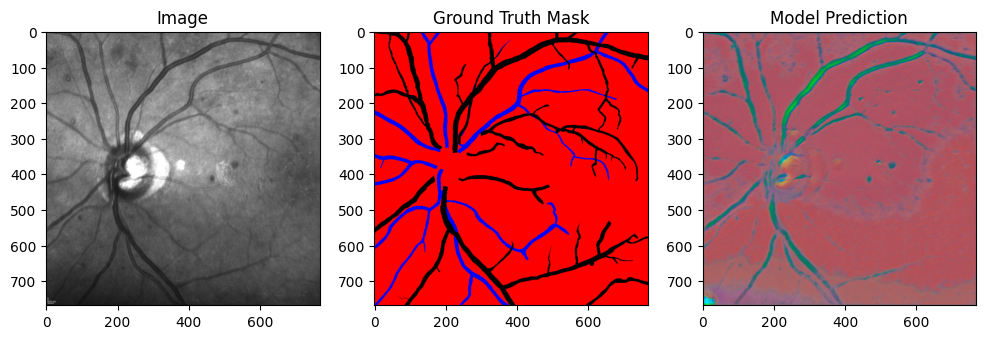

100%|██████████| 3/3 [00:03<00:00,  1.14s/it]


Validation Loss
IOU Loss: 0.22857779264450073 DICE Loss: 0.17392055690288544
Validation Loss: 0.5219757556915283


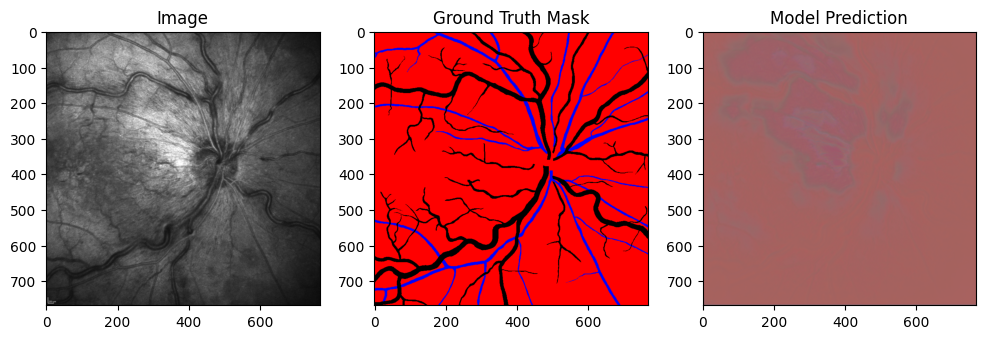

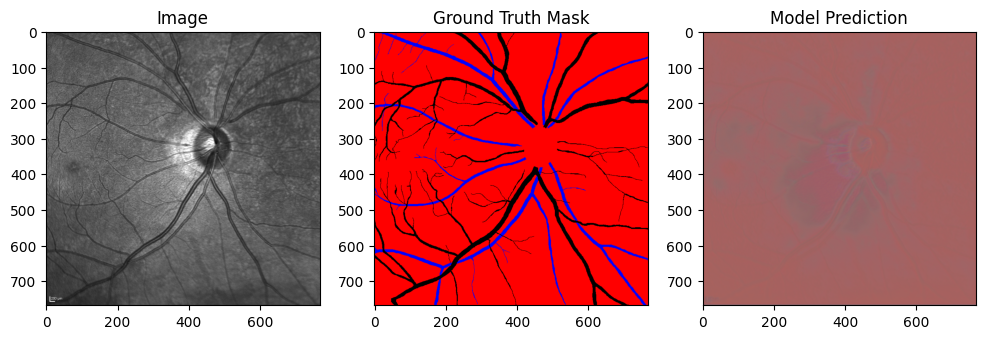

100%|██████████| 27/27 [00:39<00:00,  1.46s/it]


Train Results
IOU Loss: 0.02403024397790432,IOU: 0.23017189434035815 , DICE Loss: 0.017784595489501953, MAPE Loss: 0.013265173882246017
Epoch 2/150, Loss: 0.48268614102292945


100%|██████████| 27/27 [00:39<00:00,  1.47s/it]


Train Results
IOU Loss: 0.02362336963415146,IOU: 0.23020085022409884 , DICE Loss: 0.017342472448945045, MAPE Loss: 0.01236914936453104
Epoch 3/150, Loss: 0.46151931970207777


100%|██████████| 27/27 [00:41<00:00,  1.55s/it]


Train Results
IOU Loss: 0.023291733115911484,IOU: 0.23019826493963128 , DICE Loss: 0.01698734611272812, MAPE Loss: 0.012393909506499767
Epoch 4/150, Loss: 0.44680717145955123


100%|██████████| 27/27 [00:40<00:00,  1.51s/it]


Train Results
IOU Loss: 0.02290606126189232,IOU: 0.23020014786861998 , DICE Loss: 0.016580142080783844, MAPE Loss: 0.01211554929614067
Epoch 5/150, Loss: 0.43375533598440663


100%|██████████| 27/27 [00:40<00:00,  1.51s/it]


Train Results
IOU Loss: 0.022475097328424454,IOU: 0.2302049410959112 , DICE Loss: 0.01613232120871544, MAPE Loss: 0.011602730490267277
Epoch 6/150, Loss: 0.4202969228779828


100%|██████████| 27/27 [00:41<00:00,  1.52s/it]


Train Results
IOU Loss: 0.022054769098758698,IOU: 0.23020826615439396 , DICE Loss: 0.01570270024240017, MAPE Loss: 0.011257050558924675
Epoch 7/150, Loss: 0.40932911413687245


100%|██████████| 27/27 [00:41<00:00,  1.52s/it]


Train Results
IOU Loss: 0.02190573140978813,IOU: 0.2302123184448298 , DICE Loss: 0.015552030876278877, MAPE Loss: 0.010973852127790451
Epoch 8/150, Loss: 0.39486621927331994


100%|██████████| 27/27 [00:40<00:00,  1.51s/it]


Train Results
IOU Loss: 0.021537719294428825,IOU: 0.23021642840660206 , DICE Loss: 0.015183649957180023, MAPE Loss: 0.010579024441540241
Epoch 9/150, Loss: 0.3825858467155033


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.021089527755975723,IOU: 0.2302207137440567 , DICE Loss: 0.01474191714078188, MAPE Loss: 0.010441293008625507
Epoch 10/150, Loss: 0.3713358795201337


100%|██████████| 27/27 [00:41<00:00,  1.53s/it]


Train Results
IOU Loss: 0.02059818059206009,IOU: 0.23022085445829177 , DICE Loss: 0.014266164042055607, MAPE Loss: 0.010102559812366962
Epoch 11/150, Loss: 0.3593476580248939


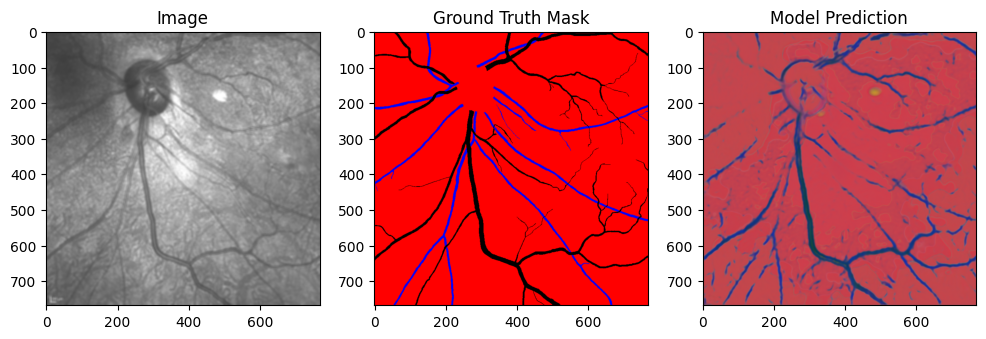

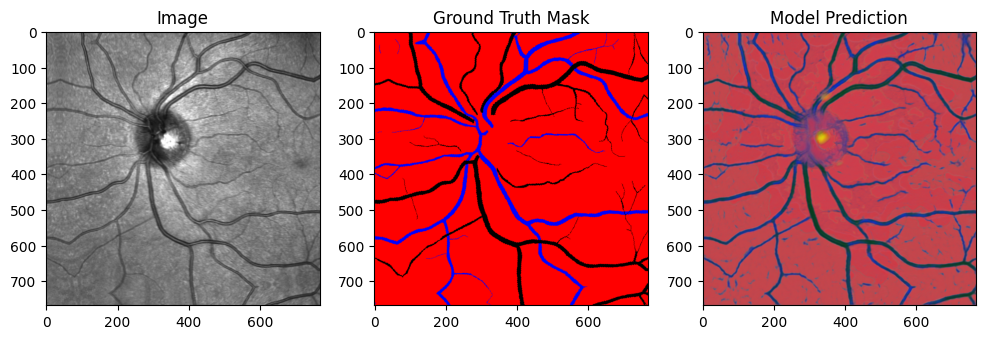

100%|██████████| 3/3 [00:00<00:00,  3.03it/s]


Validation Loss
IOU Loss: 0.18731193244457245 DICE Loss: 0.1302529275417328
Validation Loss: 0.3569035232067108


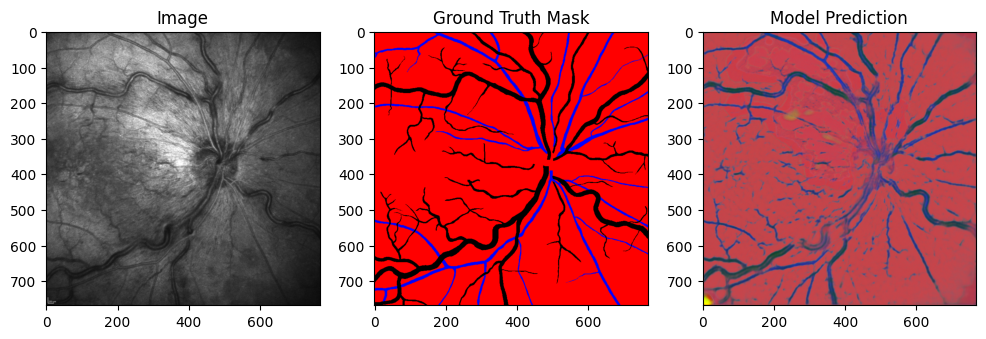

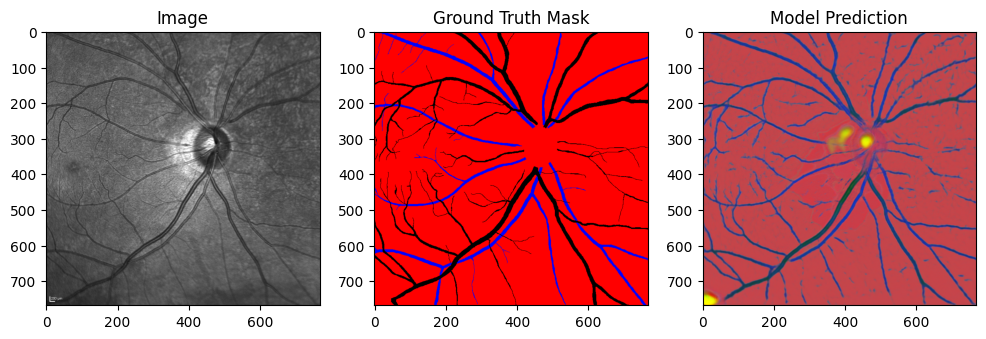

100%|██████████| 27/27 [00:41<00:00,  1.53s/it]


Train Results
IOU Loss: 0.020542427897453308,IOU: 0.23022224503016986 , DICE Loss: 0.014212732203304768, MAPE Loss: 0.009865821339190006
Epoch 12/150, Loss: 0.34925372733010185


100%|██████████| 27/27 [00:41<00:00,  1.54s/it]


Train Results
IOU Loss: 0.019956134259700775,IOU: 0.2302242693784163 , DICE Loss: 0.01365751028060913, MAPE Loss: 0.009608365595340729
Epoch 13/150, Loss: 0.3379928878060094


100%|██████████| 27/27 [00:41<00:00,  1.54s/it]


Train Results
IOU Loss: 0.020112941041588783,IOU: 0.23022904702237104 , DICE Loss: 0.013804824091494083, MAPE Loss: 0.009122014045715332
Epoch 14/150, Loss: 0.32724161059768114


100%|██████████| 27/27 [00:41<00:00,  1.55s/it]


Train Results
IOU Loss: 0.019387705251574516,IOU: 0.2302304747409527 , DICE Loss: 0.013130574487149715, MAPE Loss: 0.008901889435946941
Epoch 15/150, Loss: 0.31804736896797464


100%|██████████| 27/27 [00:41<00:00,  1.55s/it]


Train Results
IOU Loss: 0.01901164837181568,IOU: 0.23022812623982022 , DICE Loss: 0.01278794463723898, MAPE Loss: 0.008733904920518398
Epoch 16/150, Loss: 0.30875592209674696


100%|██████████| 27/27 [00:41<00:00,  1.55s/it]


Train Results
IOU Loss: 0.018502317368984222,IOU: 0.2302261818769579 , DICE Loss: 0.012331287376582623, MAPE Loss: 0.008584576658904552
Epoch 17/150, Loss: 0.29969012295758285


100%|██████████| 27/27 [00:42<00:00,  1.59s/it]


Train Results
IOU Loss: 0.018679631873965263,IOU: 0.2302249425287164 , DICE Loss: 0.012489312328398228, MAPE Loss: 0.008210877887904644
Epoch 18/150, Loss: 0.29061725956422313


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.017813701182603836,IOU: 0.2302230116325696 , DICE Loss: 0.011727026663720608, MAPE Loss: 0.008025293238461018
Epoch 19/150, Loss: 0.2819124195310805


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.017789006233215332,IOU: 0.23022471420504376 , DICE Loss: 0.011705632321536541, MAPE Loss: 0.0078194011002779
Epoch 20/150, Loss: 0.27376295902110914


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.017343470826745033,IOU: 0.23022230163556942 , DICE Loss: 0.011322831735014915, MAPE Loss: 0.007840183563530445
Epoch 21/150, Loss: 0.2664505795196251


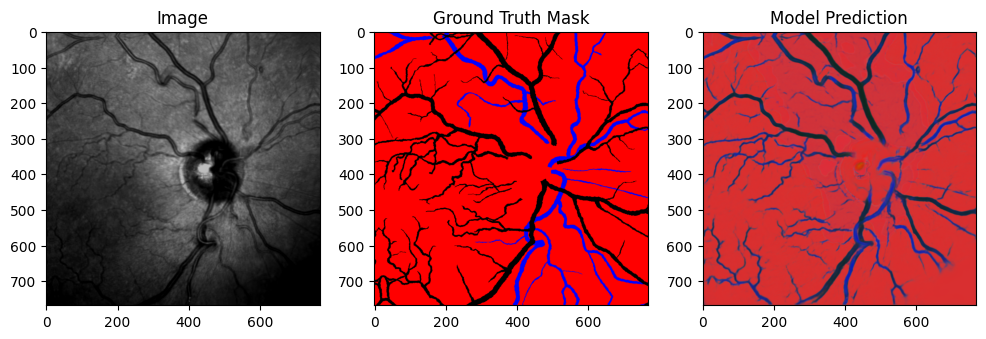

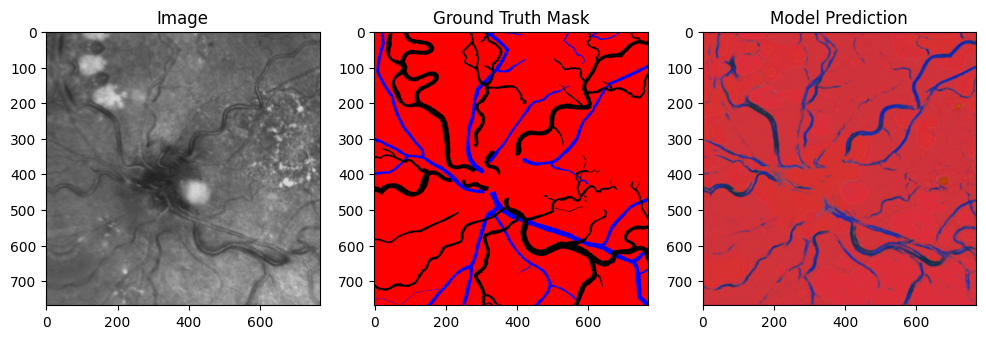

100%|██████████| 3/3 [00:01<00:00,  2.74it/s]


Validation Loss
IOU Loss: 0.1598958820104599 DICE Loss: 0.10517311096191406
Validation Loss: 0.2683597008387248


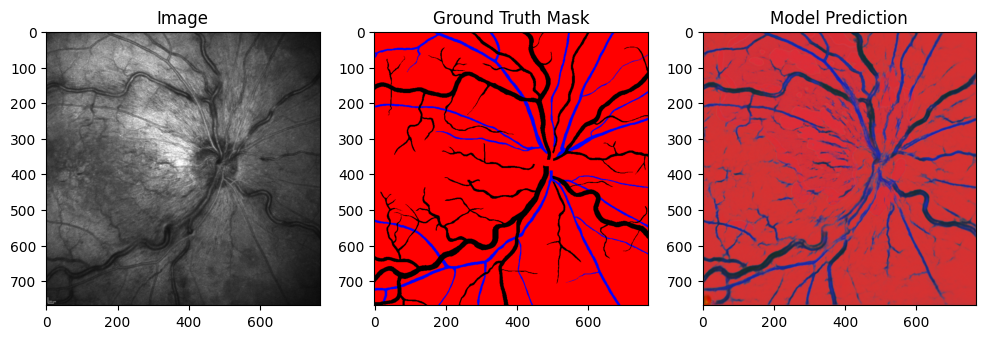

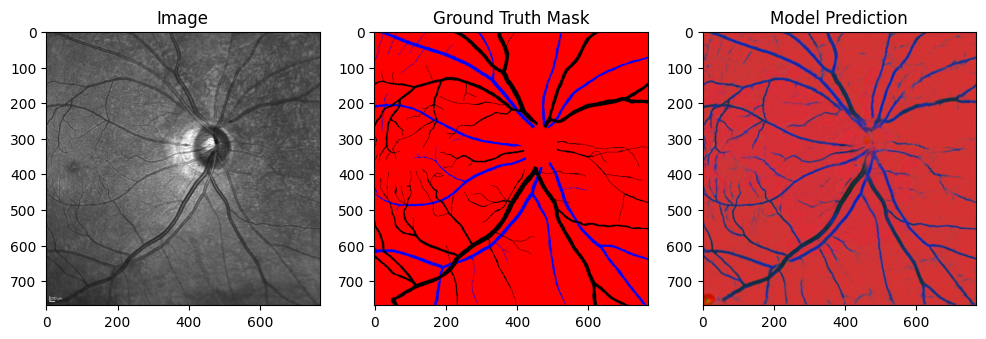

100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.017141366377472878,IOU: 0.23022472798470006 , DICE Loss: 0.011151159182190895, MAPE Loss: 0.0071732946671545506
Epoch 22/150, Loss: 0.2579082990134204


100%|██████████| 27/27 [00:42<00:00,  1.57s/it]


Train Results
IOU Loss: 0.016790878027677536,IOU: 0.23022512370427486 , DICE Loss: 0.010856317356228828, MAPE Loss: 0.007303175516426563
Epoch 23/150, Loss: 0.2503396957008927


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.016094719991087914,IOU: 0.23022489586975348 , DICE Loss: 0.010281262919306755, MAPE Loss: 0.007168608717620373
Epoch 24/150, Loss: 0.244690321109913


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.016239654272794724,IOU: 0.23022279827465028 , DICE Loss: 0.010399842634797096, MAPE Loss: 0.007036081049591303
Epoch 25/150, Loss: 0.23730760481622484


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.015474838204681873,IOU: 0.23022219612379466 , DICE Loss: 0.00978071615099907, MAPE Loss: 0.006772901862859726
Epoch 26/150, Loss: 0.22932480661957352


100%|██████████| 27/27 [00:42<00:00,  1.57s/it]


Train Results
IOU Loss: 0.015308795496821404,IOU: 0.230221915074264 , DICE Loss: 0.009648429229855537, MAPE Loss: 0.006446339190006256
Epoch 27/150, Loss: 0.22347533537281883


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.015248605981469154,IOU: 0.23022423448362653 , DICE Loss: 0.00960066169500351, MAPE Loss: 0.006488935090601444
Epoch 28/150, Loss: 0.21788286721264874


100%|██████████| 27/27 [00:42<00:00,  1.57s/it]


Train Results
IOU Loss: 0.014806346036493778,IOU: 0.23022427856701297 , DICE Loss: 0.009252647869288921, MAPE Loss: 0.006295188795775175
Epoch 29/150, Loss: 0.21158453987704384


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.015004003420472145,IOU: 0.2302242519179235 , DICE Loss: 0.00940753985196352, MAPE Loss: 0.0060936217196285725
Epoch 30/150, Loss: 0.20703042657287032


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.013940740376710892,IOU: 0.23022476860908503 , DICE Loss: 0.008586318232119083, MAPE Loss: 0.005942442920058966
Epoch 31/150, Loss: 0.20088194807370505


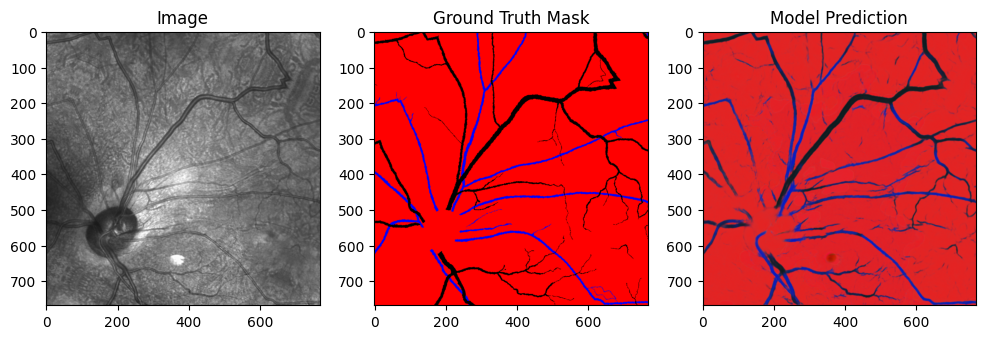

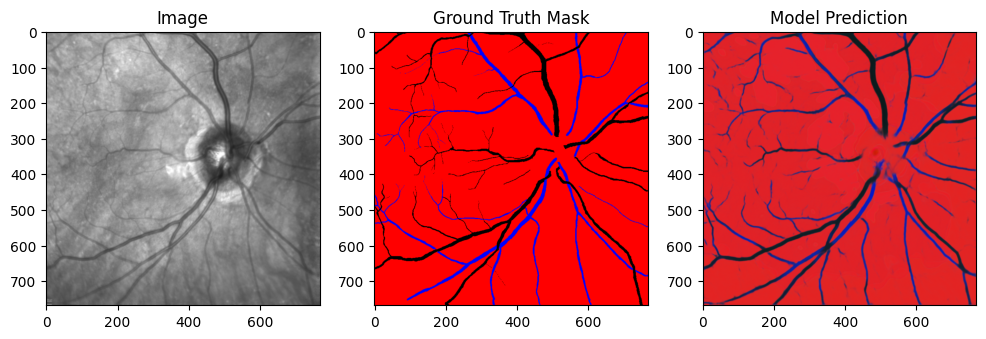

100%|██████████| 3/3 [00:01<00:00,  2.55it/s]


Validation Loss
IOU Loss: 0.1309652030467987 DICE Loss: 0.08149147033691406
Validation Loss: 0.2009138415257136


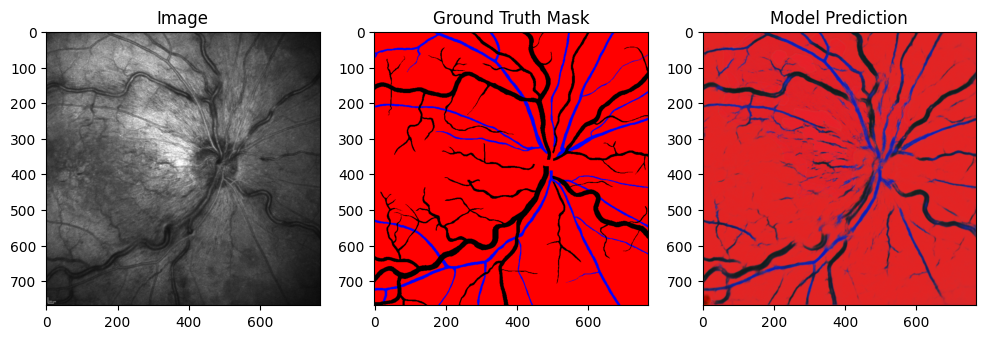

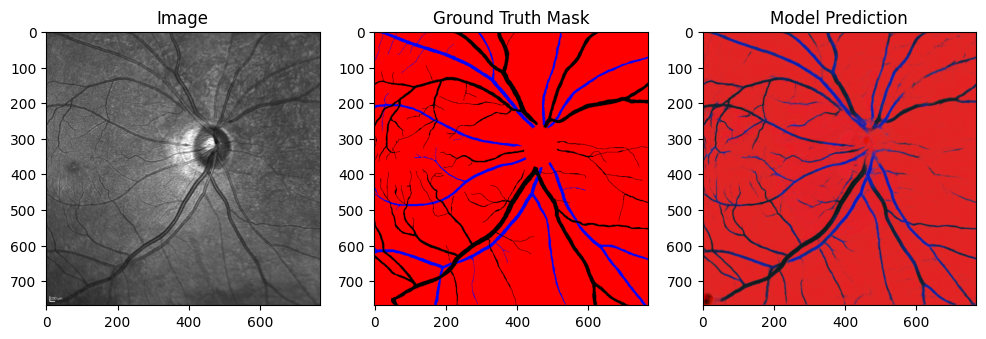

100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.013588560745120049,IOU: 0.23022208880985714 , DICE Loss: 0.008320673368871212, MAPE Loss: 0.005877768155187368
Epoch 32/150, Loss: 0.19547176857789358


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Train Results
IOU Loss: 0.013820345513522625,IOU: 0.23022034724854046 , DICE Loss: 0.008495156653225422, MAPE Loss: 0.005662498530000448
Epoch 33/150, Loss: 0.1886135670873854


100%|██████████| 27/27 [00:42<00:00,  1.59s/it]


Train Results
IOU Loss: 0.013074559159576893,IOU: 0.2302197567402552 , DICE Loss: 0.007938475348055363, MAPE Loss: 0.00549094146117568
Epoch 34/150, Loss: 0.18589682821874265


100%|██████████| 27/27 [00:42<00:00,  1.59s/it]


Train Results
IOU Loss: 0.01321539655327797,IOU: 0.2302192180159355 , DICE Loss: 0.00804255623370409, MAPE Loss: 0.005454897414892912
Epoch 35/150, Loss: 0.18027265866597494


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.012888400815427303,IOU: 0.23021863518658556 , DICE Loss: 0.007801636587828398, MAPE Loss: 0.005305586848407984
Epoch 36/150, Loss: 0.1746336078202283


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.012622050009667873,IOU: 0.2302183873628161 , DICE Loss: 0.007607290055602789, MAPE Loss: 0.005193118005990982
Epoch 37/150, Loss: 0.1720004070688177


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.012213272042572498,IOU: 0.23021752483230307 , DICE Loss: 0.007312282454222441, MAPE Loss: 0.005057786591351032
Epoch 38/150, Loss: 0.16758696569336784


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.011725567281246185,IOU: 0.230217379103004 , DICE Loss: 0.006965369917452335, MAPE Loss: 0.00482126185670495
Epoch 39/150, Loss: 0.162258122254301


100%|██████████| 27/27 [00:43<00:00,  1.61s/it]


Train Results
IOU Loss: 0.011889905668795109,IOU: 0.23021763800266512 , DICE Loss: 0.0070816585794091225, MAPE Loss: 0.004933860618621111
Epoch 40/150, Loss: 0.1577171622603028


100%|██████████| 27/27 [00:43<00:00,  1.61s/it]


Train Results
IOU Loss: 0.011602353304624557,IOU: 0.23021770644361025 , DICE Loss: 0.006878583692014217, MAPE Loss: 0.004727229941636324
Epoch 41/150, Loss: 0.15457449080767455


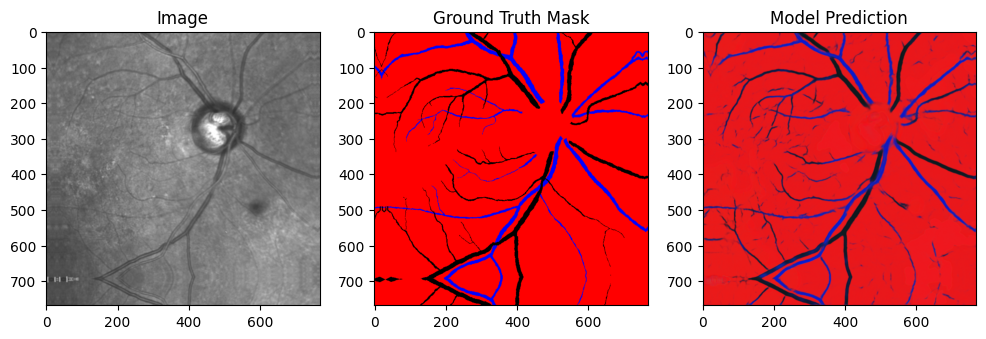

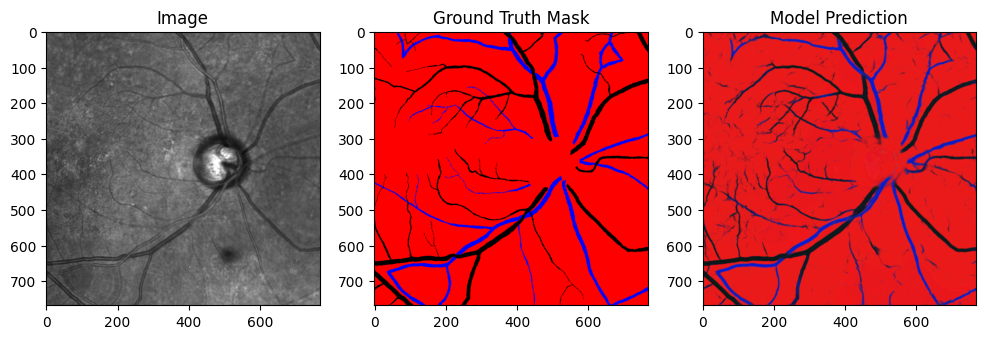

100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


Validation Loss
IOU Loss: 0.10787414014339447 DICE Loss: 0.06434959173202515
Validation Loss: 0.15732941031455994


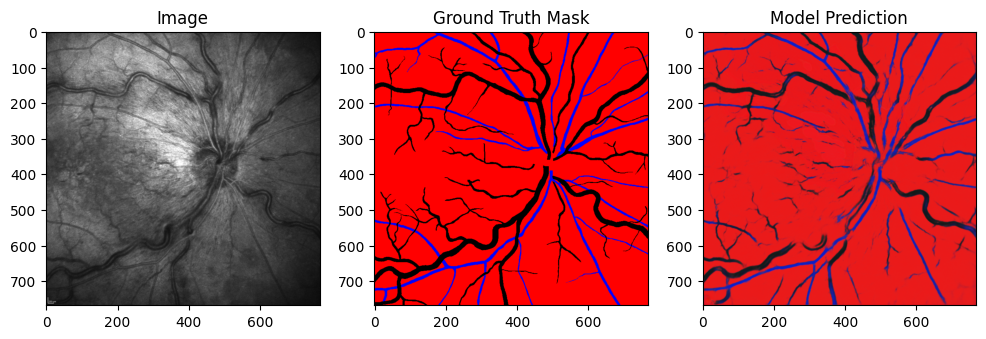

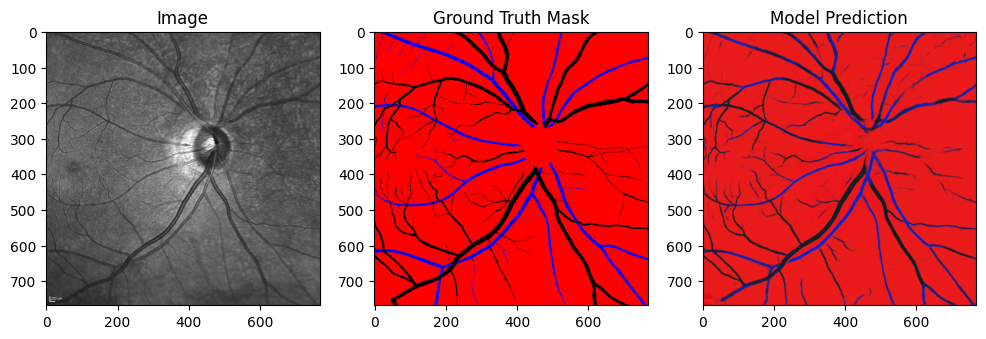

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.01152025070041418,IOU: 0.23021796905911615 , DICE Loss: 0.006820946000516415, MAPE Loss: 0.004703894257545471
Epoch 42/150, Loss: 0.15109001927905613


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.01113529596477747,IOU: 0.23021879457907446 , DICE Loss: 0.006552693899720907, MAPE Loss: 0.004409830551594496
Epoch 43/150, Loss: 0.14825081273361487


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.011065573431551456,IOU: 0.23021806150113633 , DICE Loss: 0.006504460703581572, MAPE Loss: 0.004202584270387888
Epoch 44/150, Loss: 0.1458089412362487


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.011358539573848248,IOU: 0.2302203726055043 , DICE Loss: 0.006707858294248581, MAPE Loss: 0.004498371388763189
Epoch 45/150, Loss: 0.14013107120990753


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.01055947970598936,IOU: 0.23022122861936087 , DICE Loss: 0.006157513242214918, MAPE Loss: 0.004289827309548855
Epoch 46/150, Loss: 0.13719461113214493


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.010280618444085121,IOU: 0.2302213182156064 , DICE Loss: 0.005968696437776089, MAPE Loss: 0.004200158175081015
Epoch 47/150, Loss: 0.1344655603170395


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.009930948726832867,IOU: 0.2302211494166719 , DICE Loss: 0.005734256003051996, MAPE Loss: 0.004070597235113382
Epoch 48/150, Loss: 0.13116613582328515


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.009962592273950577,IOU: 0.23022252288371545 , DICE Loss: 0.005755364894866943, MAPE Loss: 0.003934227395802736
Epoch 49/150, Loss: 0.1303463136708295


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.00978581141680479,IOU: 0.23022223054596916 , DICE Loss: 0.005637696478515863, MAPE Loss: 0.004213887266814709
Epoch 51/150, Loss: 0.1270547851368233


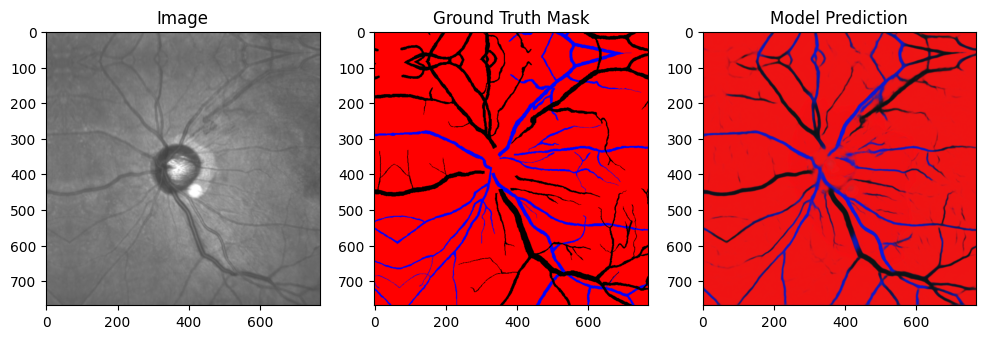

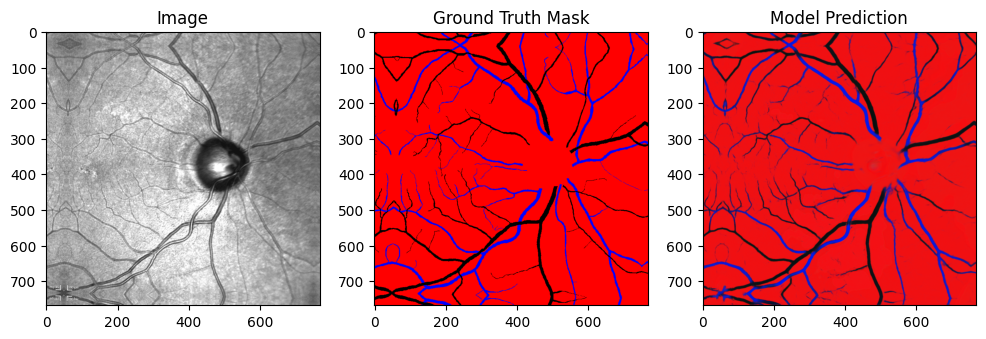

100%|██████████| 3/3 [00:01<00:00,  2.83it/s]


Validation Loss
IOU Loss: 0.09135659784078598 DICE Loss: 0.05293184518814087
Validation Loss: 0.12978358566761017


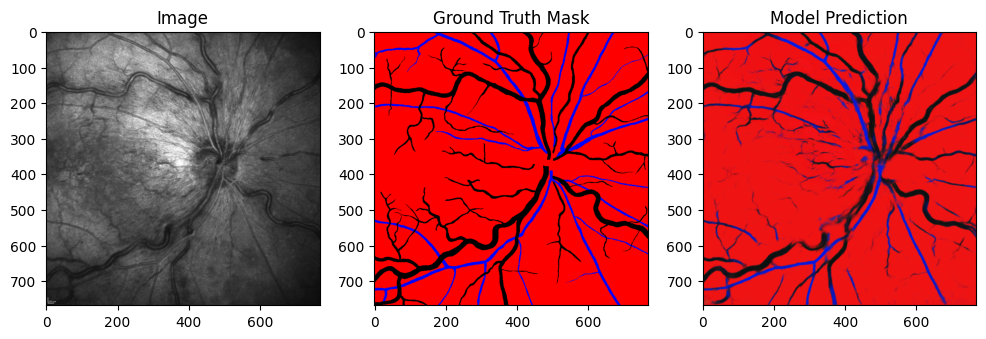

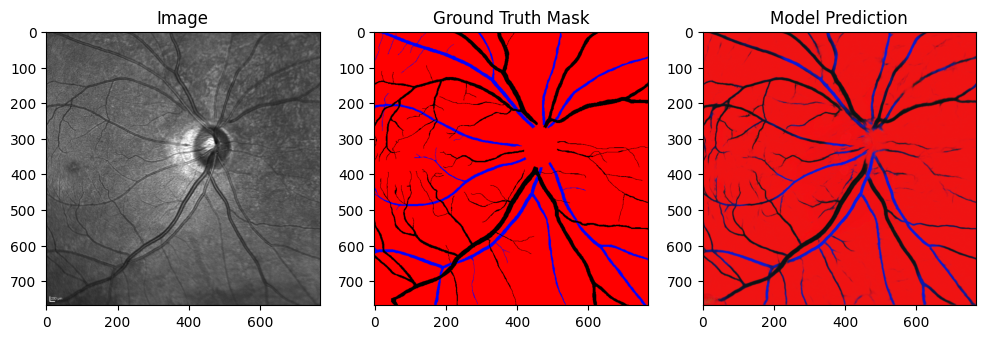

100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.008907891809940338,IOU: 0.23022376293914829 , DICE Loss: 0.005062780808657408, MAPE Loss: 0.003619480412453413
Epoch 52/150, Loss: 0.12207032519358176


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.00925119686871767,IOU: 0.23022409096767604 , DICE Loss: 0.005285744555294514, MAPE Loss: 0.003374400781467557
Epoch 53/150, Loss: 0.1180668020689929


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.009086997248232365,IOU: 0.23022424043164644 , DICE Loss: 0.005178806837648153, MAPE Loss: 0.00363808311522007
Epoch 54/150, Loss: 0.11714175343513489


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.0088680824264884,IOU: 0.23022387761023544 , DICE Loss: 0.00503707816824317, MAPE Loss: 0.003405279014259577
Epoch 55/150, Loss: 0.11314092935235412


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.008918744511902332,IOU: 0.23022410466082457 , DICE Loss: 0.0050697922706604, MAPE Loss: 0.003138601779937744
Epoch 56/150, Loss: 0.11194882900626571


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.008347566239535809,IOU: 0.23022288971795526 , DICE Loss: 0.004703875165432692, MAPE Loss: 0.003504840424284339
Epoch 57/150, Loss: 0.11011176142427656


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.008262062445282936,IOU: 0.23022261382092846 , DICE Loss: 0.004649645648896694, MAPE Loss: 0.0033420883119106293
Epoch 58/150, Loss: 0.10649606778665825


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.008111786097288132,IOU: 0.23022223440200754 , DICE Loss: 0.0045546735636889935, MAPE Loss: 0.0032227691262960434
Epoch 59/150, Loss: 0.10415771189663145


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.008021253161132336,IOU: 0.23022226822883177 , DICE Loss: 0.00449766730889678, MAPE Loss: 0.003258898388594389
Epoch 60/150, Loss: 0.10594891066904422


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007831140421330929,IOU: 0.23022256458723425 , DICE Loss: 0.004378464538604021, MAPE Loss: 0.0031325635500252247
Epoch 61/150, Loss: 0.10114896242265348


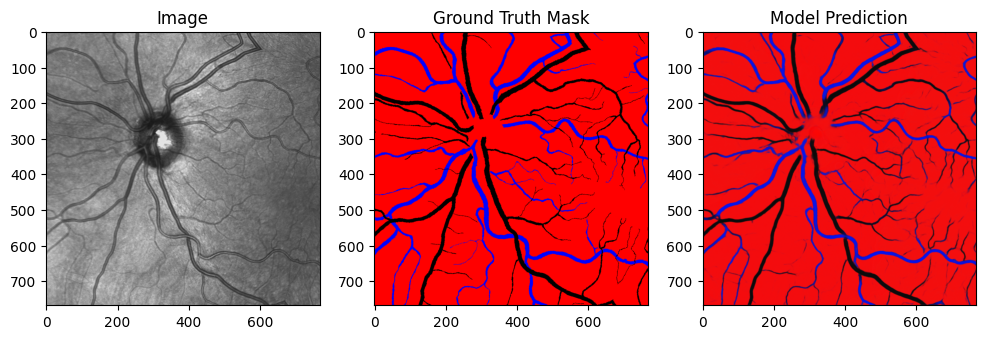

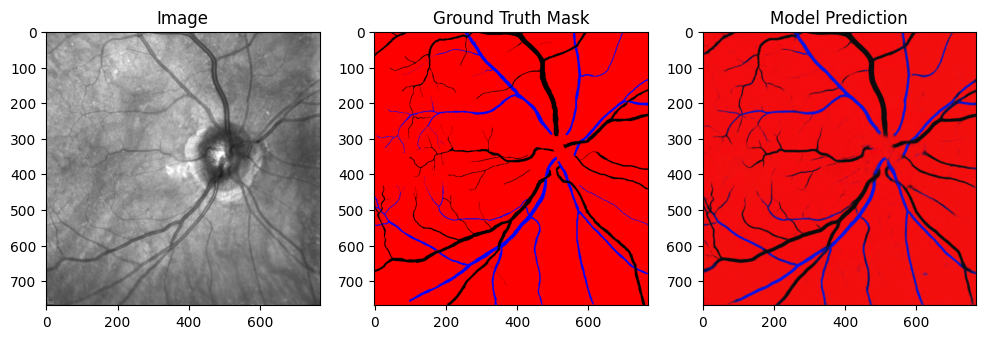

100%|██████████| 3/3 [00:01<00:00,  2.68it/s]


Validation Loss
IOU Loss: 0.07621616125106812 DICE Loss: 0.04302716255187988
Validation Loss: 0.10970469067494075


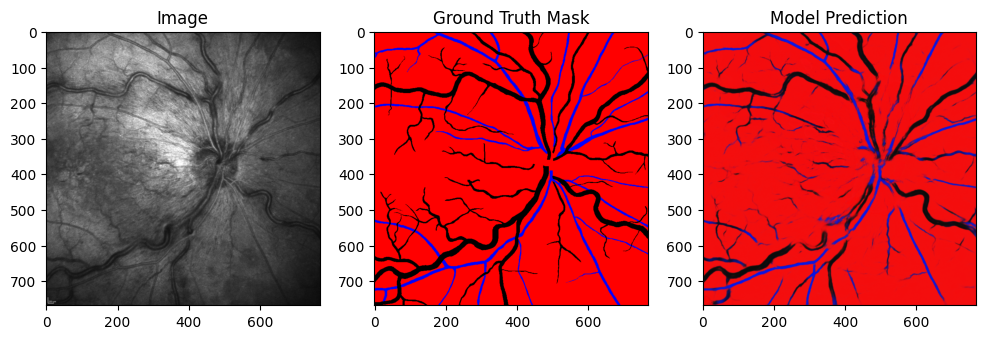

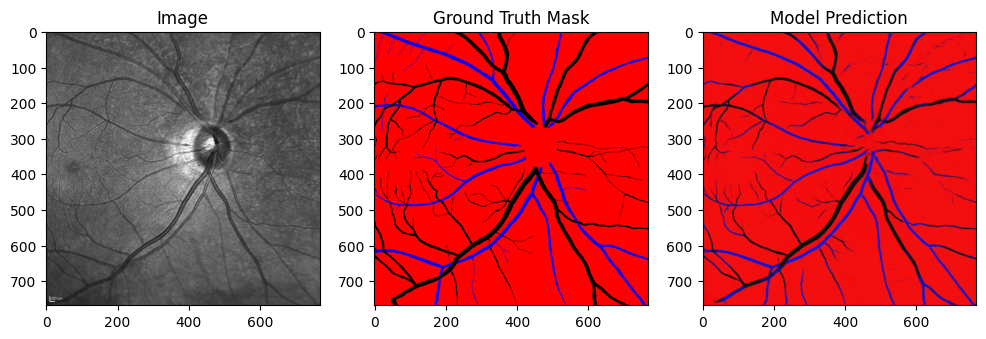

100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007836719043552876,IOU: 0.23022172661913018 , DICE Loss: 0.004381952341645956, MAPE Loss: 0.003301638178527355
Epoch 62/150, Loss: 0.099610668917497


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007576019503176212,IOU: 0.23022068921920322 , DICE Loss: 0.004219573922455311, MAPE Loss: 0.003054664470255375
Epoch 63/150, Loss: 0.0983684832851092


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007281365338712931,IOU: 0.23022054862801647 , DICE Loss: 0.004037570208311081, MAPE Loss: 0.0030659199692308903
Epoch 64/150, Loss: 0.09290468913537485


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.007171224802732468,IOU: 0.23022167220167153 , DICE Loss: 0.003969949670135975, MAPE Loss: 0.0028566326946020126
Epoch 65/150, Loss: 0.09670890619357426


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007548775989562273,IOU: 0.2302224197469094 , DICE Loss: 0.004202679265290499, MAPE Loss: 0.0032229300122708082
Epoch 66/150, Loss: 0.09461690016366818


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.00710133695974946,IOU: 0.2302233272655818 , DICE Loss: 0.003927160054445267, MAPE Loss: 0.002550948178395629
Epoch 67/150, Loss: 0.08985256265710902


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006868517026305199,IOU: 0.23022221943058493 , DICE Loss: 0.0037852481473237276, MAPE Loss: 0.002969956025481224
Epoch 68/150, Loss: 0.08944524548671863


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.007162312511354685,IOU: 0.23022174201330778 , DICE Loss: 0.003964490257203579, MAPE Loss: 0.0030545350164175034
Epoch 69/150, Loss: 0.08957086751858394


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007090115919709206,IOU: 0.2302210648885721 , DICE Loss: 0.003920296672731638, MAPE Loss: 0.003021305426955223
Epoch 70/150, Loss: 0.08650172860534103


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006653266958892345,IOU: 0.23022064110912724 , DICE Loss: 0.0036549149081110954, MAPE Loss: 0.0028511208947747946
Epoch 71/150, Loss: 0.08430715401967366


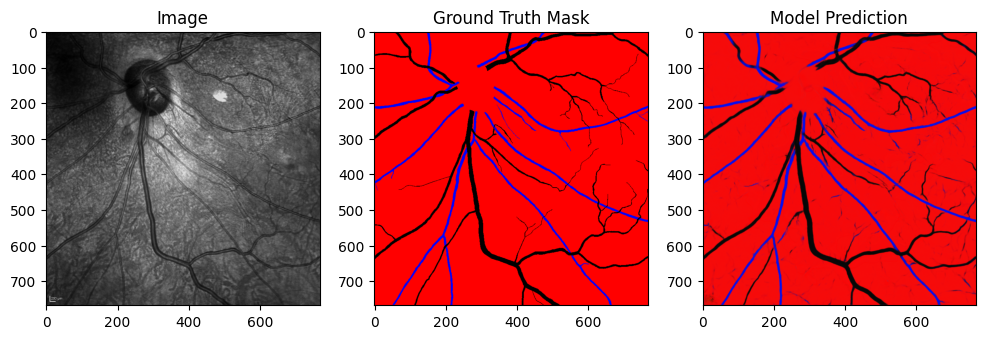

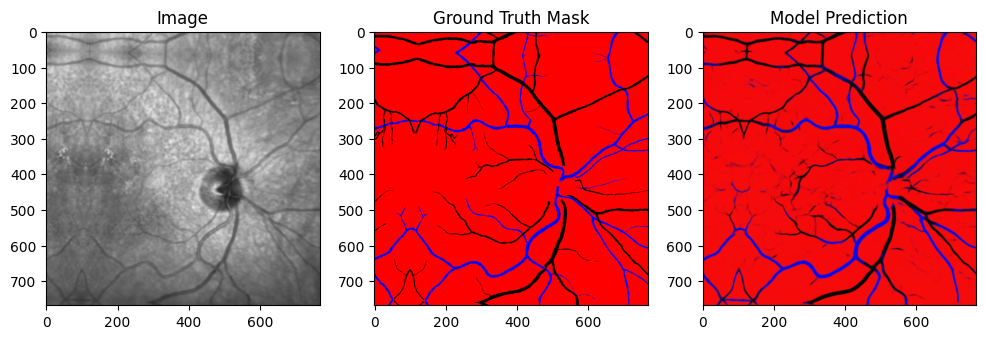

100%|██████████| 3/3 [00:01<00:00,  2.74it/s]


Validation Loss
IOU Loss: 0.0665859580039978 DICE Loss: 0.036987245082855225
Validation Loss: 0.09824667125940323


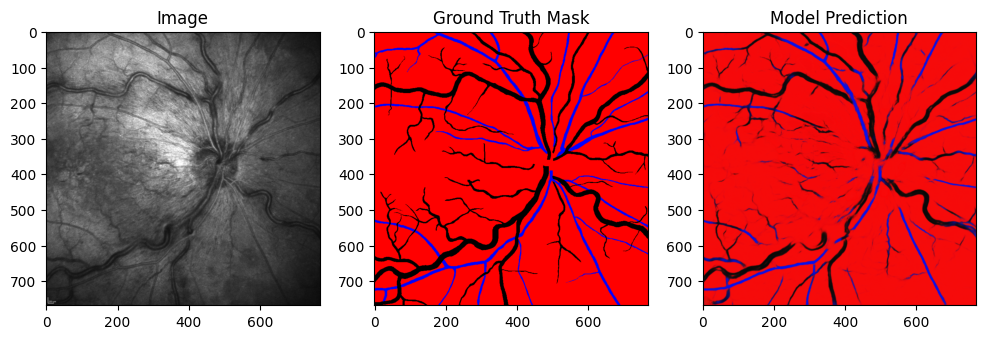

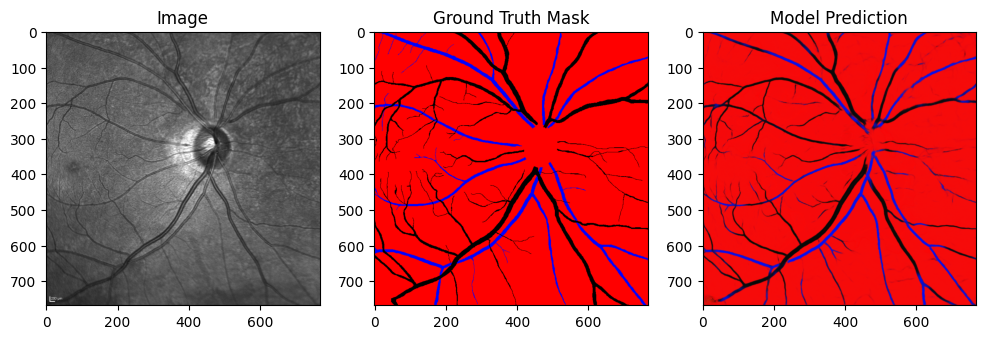

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006075607612729073,IOU: 0.23021969332271297 , DICE Loss: 0.003309230087324977, MAPE Loss: 0.002614762866869569
Epoch 72/150, Loss: 0.08243839829056351


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006705946289002895,IOU: 0.23022060622594057 , DICE Loss: 0.003686734940856695, MAPE Loss: 0.002568667521700263
Epoch 73/150, Loss: 0.08378428827833247


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.006465869955718517,IOU: 0.23022054402281575 , DICE Loss: 0.0035421252250671387, MAPE Loss: 0.0027581905014812946
Epoch 74/150, Loss: 0.08200415858515987


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.007060245145112276,IOU: 0.23022010141566585 , DICE Loss: 0.0039020401891320944, MAPE Loss: 0.002673352137207985
Epoch 75/150, Loss: 0.08033496141433716


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.006209497340023518,IOU: 0.23022018065220887 , DICE Loss: 0.0033888288307935, MAPE Loss: 0.0025277379900217056
Epoch 76/150, Loss: 0.0774671948618359


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.006328410468995571,IOU: 0.23022033344547632 , DICE Loss: 0.003459789091721177, MAPE Loss: 0.002324658213183284
Epoch 77/150, Loss: 0.07949198064980684


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.006866556592285633,IOU: 0.23022093247429767 , DICE Loss: 0.00378405605442822, MAPE Loss: 0.003165934234857559
Epoch 78/150, Loss: 0.0753689678730788


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006543861702084541,IOU: 0.2302219093042215 , DICE Loss: 0.003588989842683077, MAPE Loss: 0.002690191613510251
Epoch 79/150, Loss: 0.07831201619572109


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.005455646198242903,IOU: 0.23022247535974183 , DICE Loss: 0.0029447057750076056, MAPE Loss: 0.002388730412349105
Epoch 80/150, Loss: 0.07382253143522474


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.005784577690064907,IOU: 0.23022268965503953 , DICE Loss: 0.003137286053970456, MAPE Loss: 0.0021034495439380407
Epoch 81/150, Loss: 0.07255726390414768


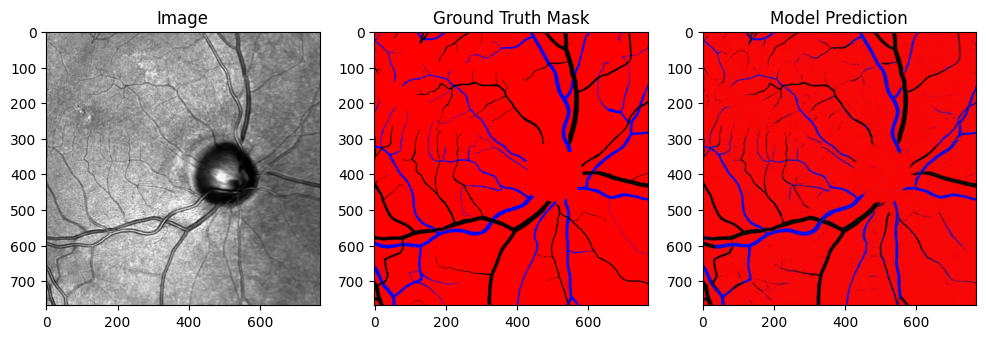

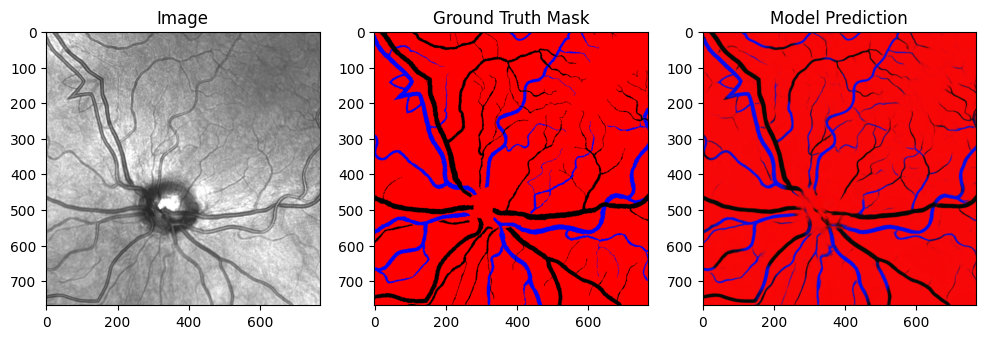

100%|██████████| 3/3 [00:01<00:00,  2.69it/s]


Validation Loss
IOU Loss: 0.0583873987197876 DICE Loss: 0.031995974481105804
Validation Loss: 0.08929019172986348


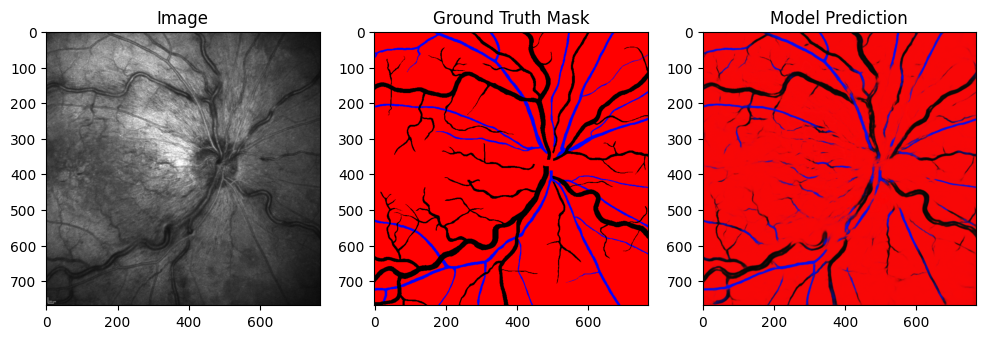

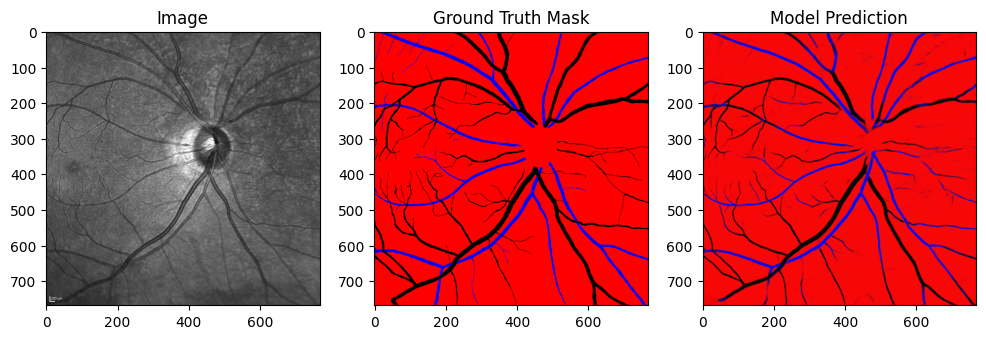

100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005665648728609085,IOU: 0.23022184455226036 , DICE Loss: 0.0030674426816403866, MAPE Loss: 0.002222946612164378
Epoch 82/150, Loss: 0.07040280020899242


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005572939291596413,IOU: 0.23022174277777316 , DICE Loss: 0.003013164969161153, MAPE Loss: 0.0025381911545991898
Epoch 83/150, Loss: 0.07069069974952275


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005346786230802536,IOU: 0.23022066414892228 , DICE Loss: 0.0028813767712563276, MAPE Loss: 0.00232828501611948
Epoch 84/150, Loss: 0.07086822556124793


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.006097747478634119,IOU: 0.23022209997953577 , DICE Loss: 0.0033223717473447323, MAPE Loss: 0.002403408056125045
Epoch 85/150, Loss: 0.07173642833475713


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0055977837182581425,IOU: 0.2302217766962806 , DICE Loss: 0.0030276973266154528, MAPE Loss: 0.002496953820809722
Epoch 86/150, Loss: 0.07154953259008902


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005356104113161564,IOU: 0.2302219428621349 , DICE Loss: 0.0028867898508906364, MAPE Loss: 0.002191763836890459
Epoch 87/150, Loss: 0.07155736315029639


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.0049480353482067585,IOU: 0.23022182081813758 , DICE Loss: 0.0026511086616665125, MAPE Loss: 0.0021405224688351154
Epoch 88/150, Loss: 0.06598483357164595


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.005426579155027866,IOU: 0.23022190095032857 , DICE Loss: 0.002927775727584958, MAPE Loss: 0.0027199541218578815
Epoch 89/150, Loss: 0.06539356708526611


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.004985985811799765,IOU: 0.23022121566464696 , DICE Loss: 0.0026729085948318243, MAPE Loss: 0.0022405318450182676
Epoch 90/150, Loss: 0.06655369036727482


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004996911156922579,IOU: 0.23022062157427584 , DICE Loss: 0.0026791889686137438, MAPE Loss: 0.0023412290029227734
Epoch 91/150, Loss: 0.06212000576434312


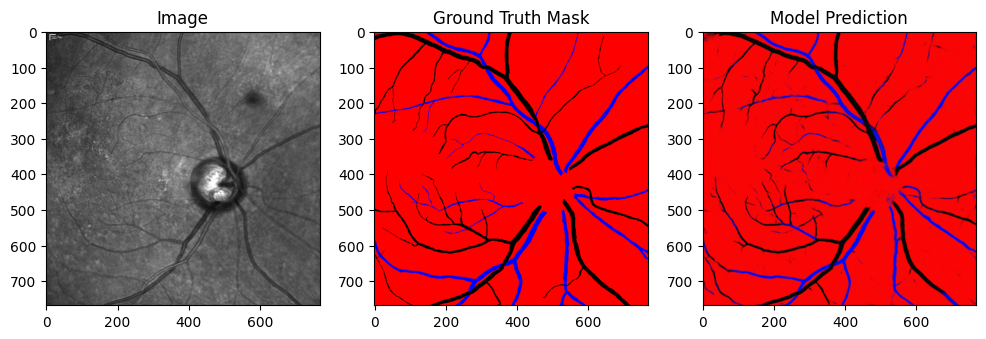

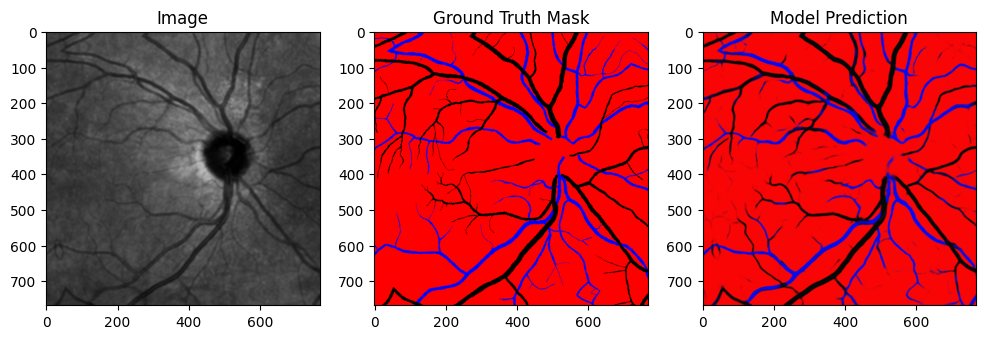

100%|██████████| 3/3 [00:01<00:00,  2.69it/s]


Validation Loss
IOU Loss: 0.053391098976135254 DICE Loss: 0.029019653797149658
Validation Loss: 0.0819963663816452


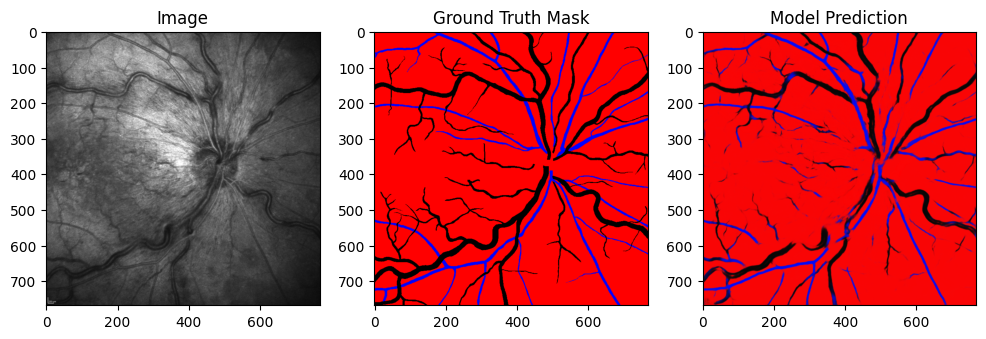

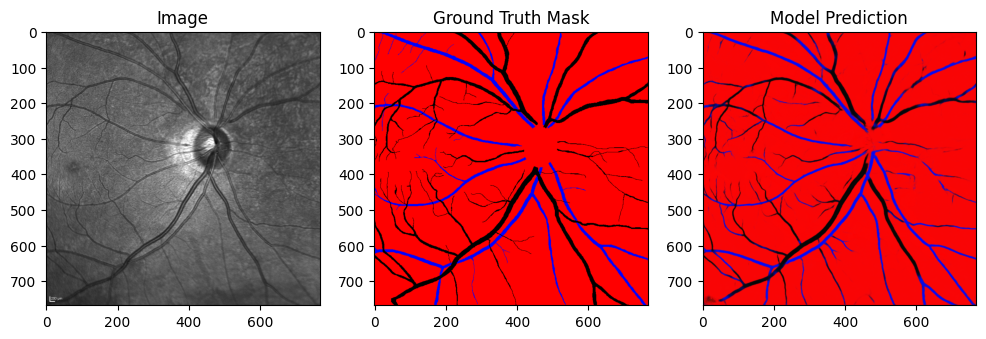

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0043445760384202,IOU: 0.23022064398881237 , DICE Loss: 0.0023076357319951057, MAPE Loss: 0.0018399566179141402
Epoch 92/150, Loss: 0.06190648150664789


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.004735443275421858,IOU: 0.23022073756727632 , DICE Loss: 0.0025294246152043343, MAPE Loss: 0.002099730307236314
Epoch 93/150, Loss: 0.06305991803054456


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005155622959136963,IOU: 0.23022048946929463 , DICE Loss: 0.002770653460174799, MAPE Loss: 0.002139178104698658
Epoch 94/150, Loss: 0.06464495192523356


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004536167252808809,IOU: 0.2302203133169748 , DICE Loss: 0.0024160388857126236, MAPE Loss: 0.0020303840283304453
Epoch 95/150, Loss: 0.06049722626253411


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0043632942251861095,IOU: 0.23021972315683178 , DICE Loss: 0.0023182013537734747, MAPE Loss: 0.0017742079216986895
Epoch 96/150, Loss: 0.06029143763913049


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.005150808487087488,IOU: 0.2302186908300874 , DICE Loss: 0.002767871832475066, MAPE Loss: 0.0022877126466482878
Epoch 97/150, Loss: 0.05880584898922178


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004811810329556465,IOU: 0.2302176027169913 , DICE Loss: 0.0025730507913976908, MAPE Loss: 0.001797197386622429
Epoch 98/150, Loss: 0.05913664800701318


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004710049368441105,IOU: 0.23021710567292275 , DICE Loss: 0.0025149406865239143, MAPE Loss: 0.002158223418518901
Epoch 99/150, Loss: 0.060042212544767944


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.004522341303527355,IOU: 0.23021747283865776 , DICE Loss: 0.0024081955198198557, MAPE Loss: 0.0019201268441975117
Epoch 100/150, Loss: 0.05672885049824362


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0040963380597531796,IOU: 0.2302178443736994 , DICE Loss: 0.0021680661011487246, MAPE Loss: 0.0018558307783678174
Epoch 101/150, Loss: 0.05810238834884432


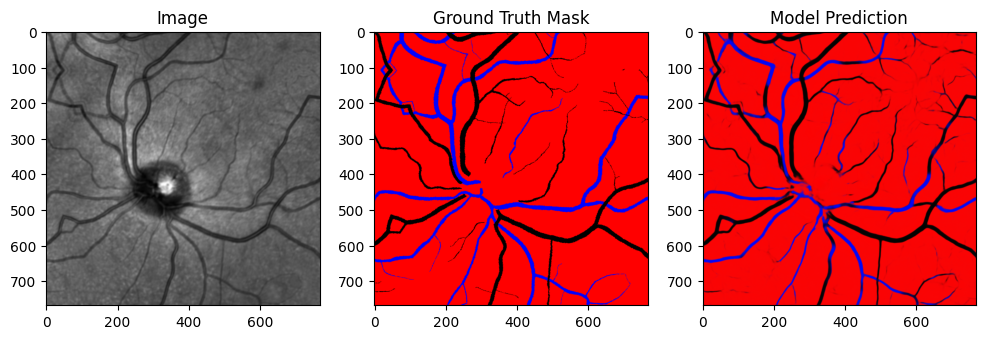

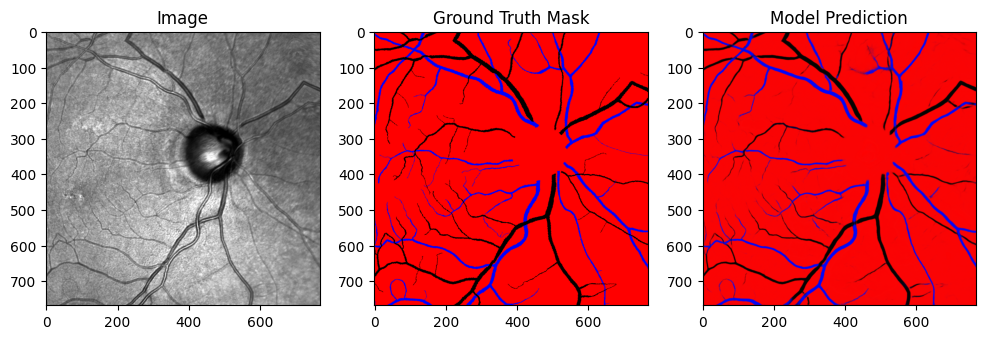

100%|██████████| 3/3 [00:01<00:00,  2.57it/s]


Validation Loss
IOU Loss: 0.048542045056819916 DICE Loss: 0.026177069172263145
Validation Loss: 0.07965247581402461


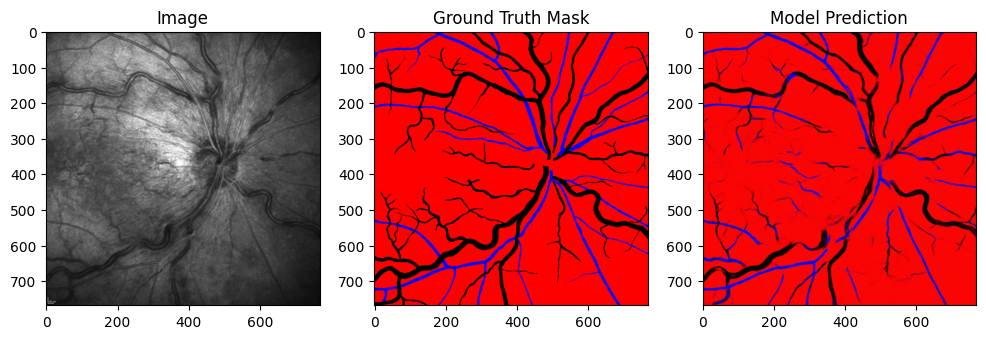

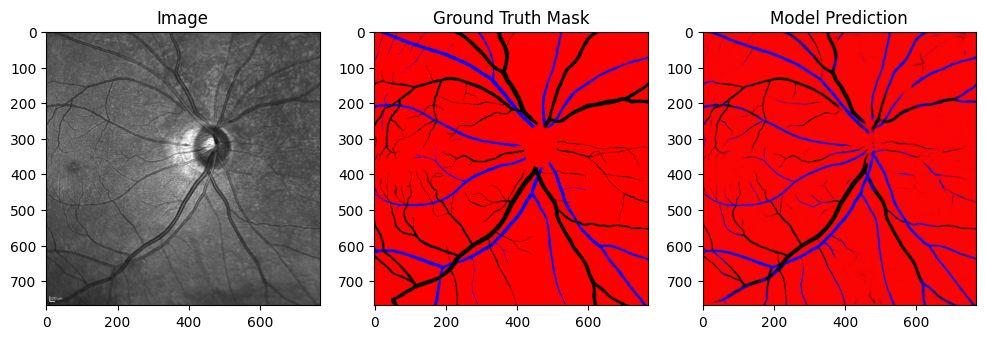

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004289465956389904,IOU: 0.2302172516746606 , DICE Loss: 0.002276566345244646, MAPE Loss: 0.002002282999455929
Epoch 102/150, Loss: 0.056775986596390056


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004532151855528355,IOU: 0.23021761245263872 , DICE Loss: 0.0024137606378644705, MAPE Loss: 0.0020561800338327885
Epoch 103/150, Loss: 0.05611590613369589


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.004103402141481638,IOU: 0.23021688005447993 , DICE Loss: 0.0021720242220908403, MAPE Loss: 0.0017187457997351885
Epoch 104/150, Loss: 0.054937933330182674


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003991857636719942,IOU: 0.23021662451683259 , DICE Loss: 0.00210961583070457, MAPE Loss: 0.0019199681701138616
Epoch 105/150, Loss: 0.055003555284606084


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004450400825589895,IOU: 0.2302164397863464 , DICE Loss: 0.0023674368858337402, MAPE Loss: 0.0020235131960362196
Epoch 106/150, Loss: 0.05429493083998009


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.004510360769927502,IOU: 0.2302160905381302 , DICE Loss: 0.002401400590315461, MAPE Loss: 0.0021432035136967897
Epoch 107/150, Loss: 0.05377795464462704


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.004071551375091076,IOU: 0.23021636325524994 , DICE Loss: 0.002154184738174081, MAPE Loss: 0.0018483638996258378
Epoch 108/150, Loss: 0.054895191142956413


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003629454877227545,IOU: 0.23021624537484386 , DICE Loss: 0.0019082272192463279, MAPE Loss: 0.0013852327829226851
Epoch 109/150, Loss: 0.054866673079905684


100%|██████████| 27/27 [00:43<00:00,  1.63s/it]


Train Results
IOU Loss: 0.0038696329575031996,IOU: 0.23021700909375875 , DICE Loss: 0.0020414635073393583, MAPE Loss: 0.0017208332428708673
Epoch 110/150, Loss: 0.052435316145420074


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.003896874375641346,IOU: 0.23021612519863976 , DICE Loss: 0.002056631725281477, MAPE Loss: 0.001736501813866198
Epoch 111/150, Loss: 0.05276791309868848


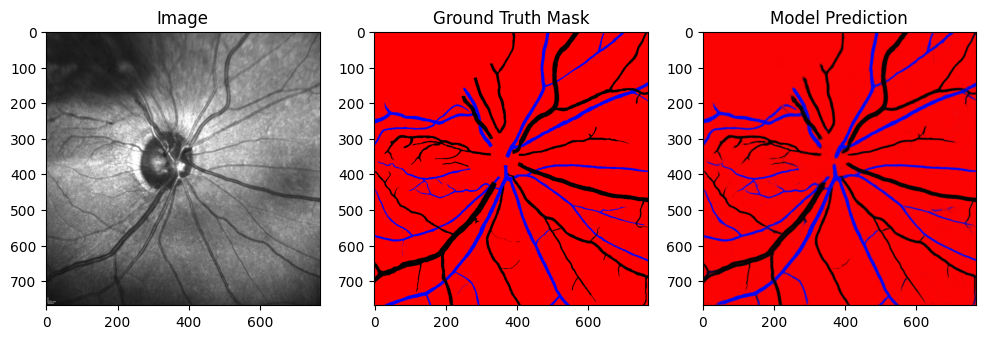

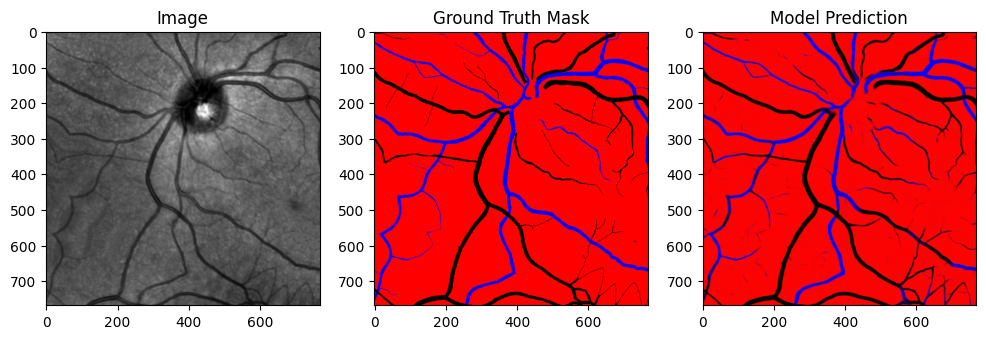

100%|██████████| 3/3 [00:01<00:00,  2.76it/s]


Validation Loss
IOU Loss: 0.04571336507797241 DICE Loss: 0.024539371952414513
Validation Loss: 0.07668516784906387


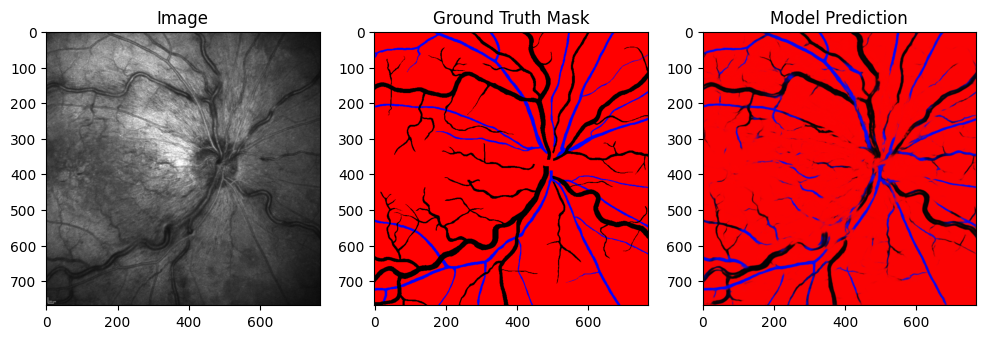

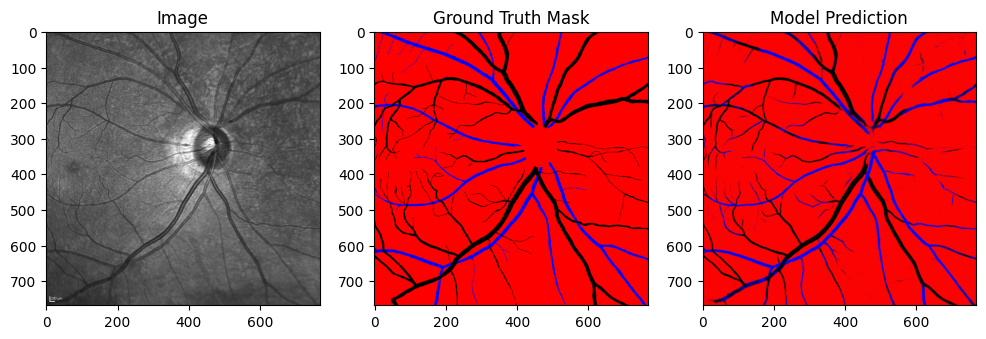

100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0037015455309301615,IOU: 0.23021572081142064 , DICE Loss: 0.0019481226336210966, MAPE Loss: 0.0016233348287642002
Epoch 112/150, Loss: 0.05116671116815673


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003773141885176301,IOU: 0.23021545583656122 , DICE Loss: 0.001987825846299529, MAPE Loss: 0.0017116216477006674
Epoch 113/150, Loss: 0.05136836816867193


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0041089435108006,IOU: 0.23021526393434885 , DICE Loss: 0.00217512808740139, MAPE Loss: 0.0016335808904841542
Epoch 114/150, Loss: 0.052023662737122285


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003920866642147303,IOU: 0.2302147885221688 , DICE Loss: 0.0020700031891465187, MAPE Loss: 0.0018386294832453132
Epoch 115/150, Loss: 0.0483680352292679


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0034410844091326,IOU: 0.2302147894902725 , DICE Loss: 0.0018043628660961986, MAPE Loss: 0.0014368986012414098
Epoch 116/150, Loss: 0.04848713938284804


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0034565108362585306,IOU: 0.23021441854167934 , DICE Loss: 0.0018128488445654511, MAPE Loss: 0.0016979689244180918
Epoch 117/150, Loss: 0.04830687893209634


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.004095620475709438,IOU: 0.23021443087708413 , DICE Loss: 0.002167664235457778, MAPE Loss: 0.0018551374087110162
Epoch 118/150, Loss: 0.050304080739065456


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.0038901986554265022,IOU: 0.23021365254744677 , DICE Loss: 0.0020529141183942556, MAPE Loss: 0.0015299429651349783
Epoch 119/150, Loss: 0.049298853509955935


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003348310710862279,IOU: 0.23021386638862876 , DICE Loss: 0.0017534141661599278, MAPE Loss: 0.0014483333798125386
Epoch 120/150, Loss: 0.047751746657821864


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003858976997435093,IOU: 0.23021359452980486 , DICE Loss: 0.0020355316810309887, MAPE Loss: 0.0018048936035484076
Epoch 121/150, Loss: 0.049188014257837226


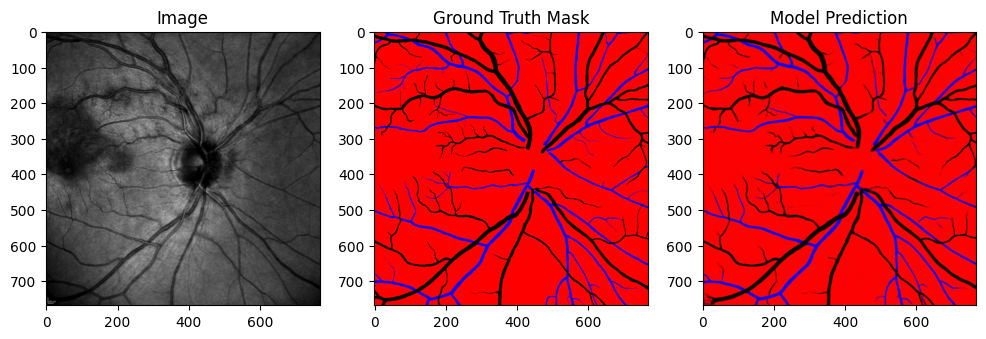

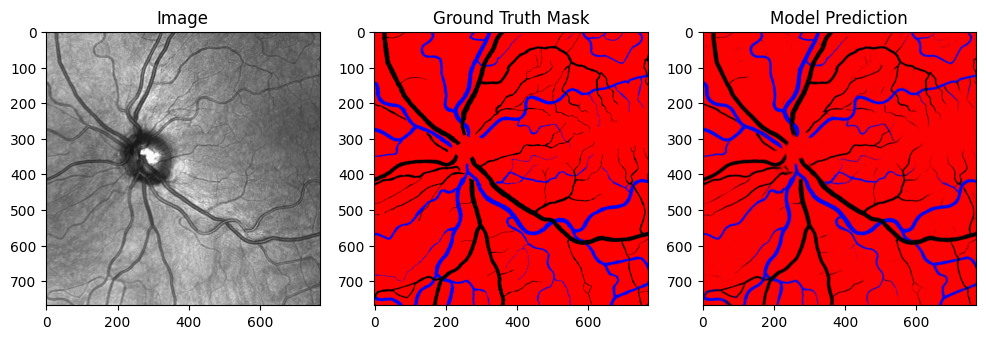

100%|██████████| 3/3 [00:01<00:00,  2.70it/s]


Validation Loss
IOU Loss: 0.04333305358886719 DICE Loss: 0.023172777146100998
Validation Loss: 0.07338865101337433


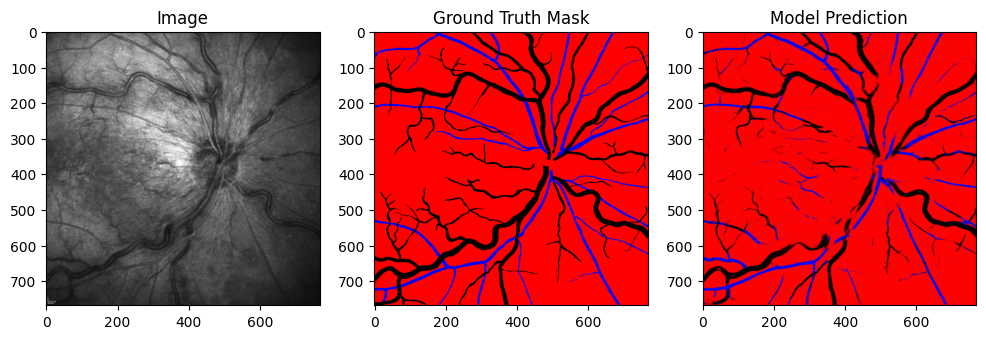

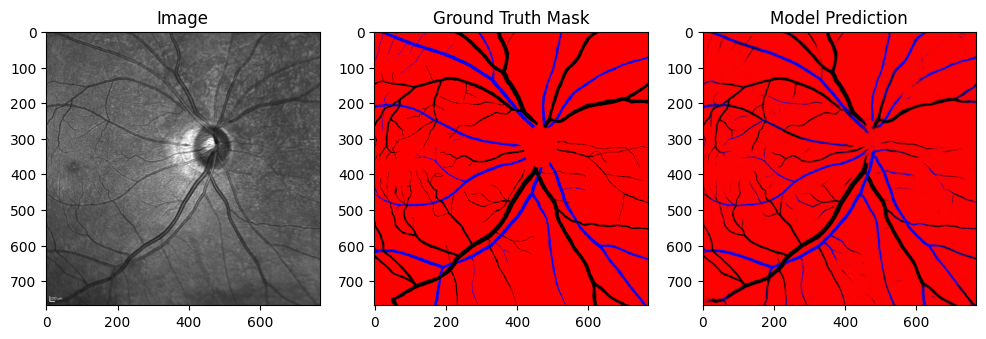

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003733646124601364,IOU: 0.23021339486789016 , DICE Loss: 0.0019659134559333324, MAPE Loss: 0.0015015614917501807
Epoch 122/150, Loss: 0.04613502985901303


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0032901610247790813,IOU: 0.2302131607311092 , DICE Loss: 0.0017215476837009192, MAPE Loss: 0.0015788680175319314
Epoch 123/150, Loss: 0.047115755163960986


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0031847511418163776,IOU: 0.23021272437921367 , DICE Loss: 0.0016639144159853458, MAPE Loss: 0.001436190796084702
Epoch 124/150, Loss: 0.04339775829403489


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0033311734441667795,IOU: 0.23021306368352945 , DICE Loss: 0.0017440164228901267, MAPE Loss: 0.001467893016524613
Epoch 125/150, Loss: 0.04696768342896744


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0028523846995085478,IOU: 0.23021327863243565 , DICE Loss: 0.0014833101304247975, MAPE Loss: 0.0012915792176499963
Epoch 126/150, Loss: 0.04554467096372887


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.003214615397155285,IOU: 0.23021281507144511 , DICE Loss: 0.0016802262980490923, MAPE Loss: 0.0015066827181726694
Epoch 127/150, Loss: 0.04663956551640122


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0036404000129550695,IOU: 0.2302135743394964 , DICE Loss: 0.0019142782548442483, MAPE Loss: 0.00166988093405962
Epoch 128/150, Loss: 0.04739508143177739


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.003261888399720192,IOU: 0.23021333661283258 , DICE Loss: 0.0017060725949704647, MAPE Loss: 0.0014856575289741158
Epoch 129/150, Loss: 0.04592692810628149


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.0032381105702370405,IOU: 0.2302132088897105 , DICE Loss: 0.001693067722953856, MAPE Loss: 0.0014572733780369163
Epoch 130/150, Loss: 0.04413964019881354


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.00297508854418993,IOU: 0.23021345159487586 , DICE Loss: 0.0015497914282605052, MAPE Loss: 0.001547279767692089
Epoch 131/150, Loss: 0.04535321435994572


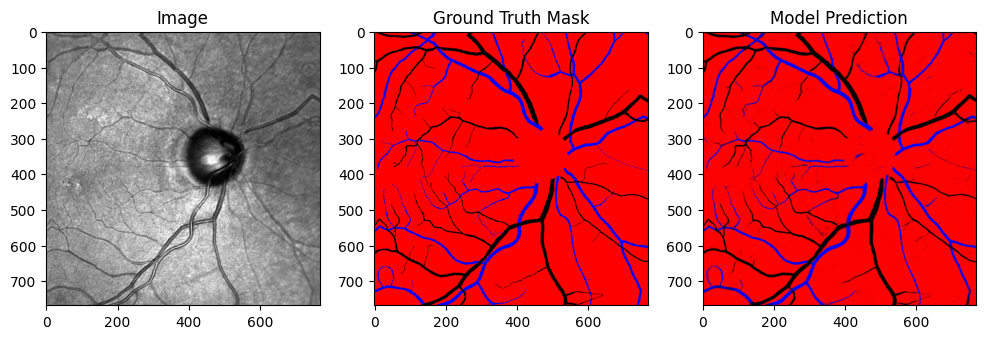

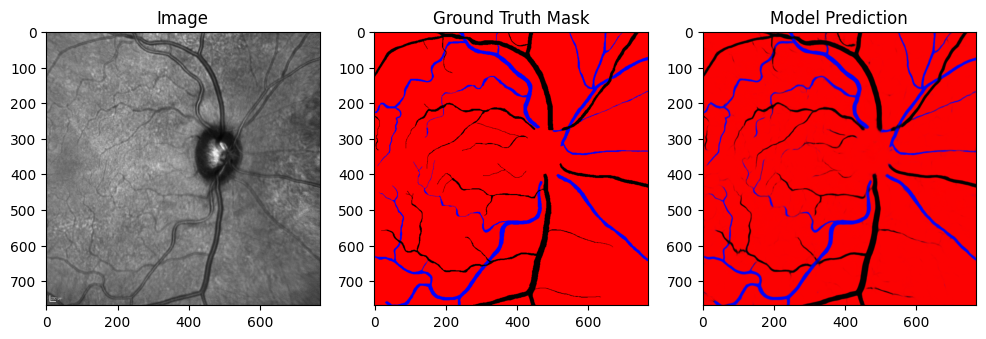

100%|██████████| 3/3 [00:01<00:00,  2.76it/s]


Validation Loss
IOU Loss: 0.04123586416244507 DICE Loss: 0.021977325901389122
Validation Loss: 0.07337005312244098


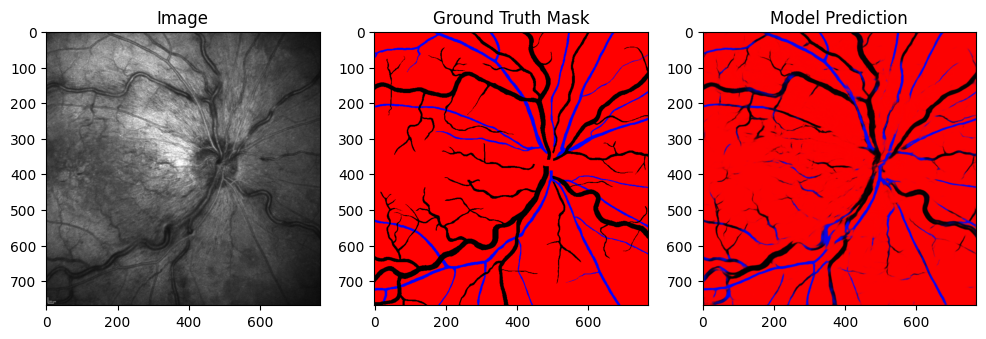

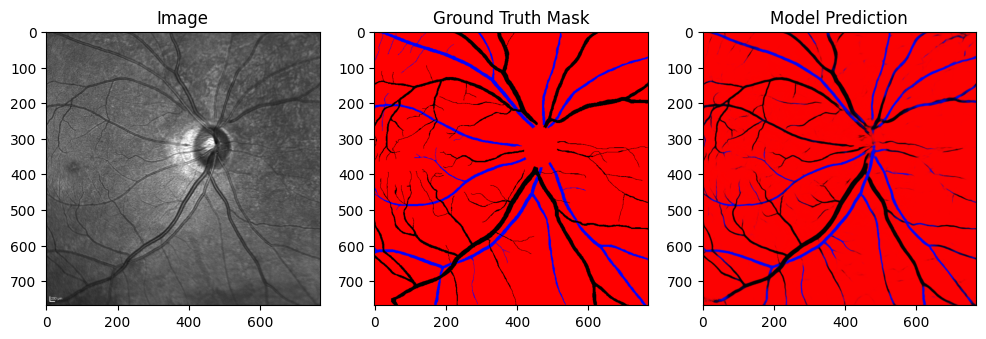

100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0035930629819631577,IOU: 0.23021389179404428 , DICE Loss: 0.001888118451461196, MAPE Loss: 0.0013903153594583273
Epoch 132/150, Loss: 0.04613152781018504


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0036535770632326603,IOU: 0.23021294803755057 , DICE Loss: 0.0019215677166357636, MAPE Loss: 0.0016427085502073169
Epoch 133/150, Loss: 0.04448180687096384


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0030937790870666504,IOU: 0.23021304711607657 , DICE Loss: 0.001614314503967762, MAPE Loss: 0.0014592520892620087
Epoch 134/150, Loss: 0.04428338700974429


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.004019247367978096,IOU: 0.23021334383085512 , DICE Loss: 0.002124920953065157, MAPE Loss: 0.0019137808121740818
Epoch 135/150, Loss: 0.04587615715960661


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.004152377601712942,IOU: 0.23021350679910857 , DICE Loss: 0.0021994863636791706, MAPE Loss: 0.0017864078981801867
Epoch 136/150, Loss: 0.04267261494640951


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Train Results
IOU Loss: 0.0027112432289868593,IOU: 0.23021360971308724 , DICE Loss: 0.0014071243349462748, MAPE Loss: 0.001227494445629418
Epoch 137/150, Loss: 0.03934694495466021


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.003629037644714117,IOU: 0.23021292690096276 , DICE Loss: 0.0019079976482316852, MAPE Loss: 0.0017574342200532556
Epoch 138/150, Loss: 0.04219675146871143


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.0026517377700656652,IOU: 0.23021301395921104 , DICE Loss: 0.0013750968500971794, MAPE Loss: 0.001112421159632504
Epoch 139/150, Loss: 0.041244567544371995


100%|██████████| 27/27 [00:44<00:00,  1.63s/it]


Train Results
IOU Loss: 0.003200396429747343,IOU: 0.2302119685462146 , DICE Loss: 0.001672457787208259, MAPE Loss: 0.0016049699625000358
Epoch 140/150, Loss: 0.0418958297620217


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0035699033178389072,IOU: 0.2302117885670046 , DICE Loss: 0.0018753320910036564, MAPE Loss: 0.001608773716725409
Epoch 141/150, Loss: 0.04211448671089278


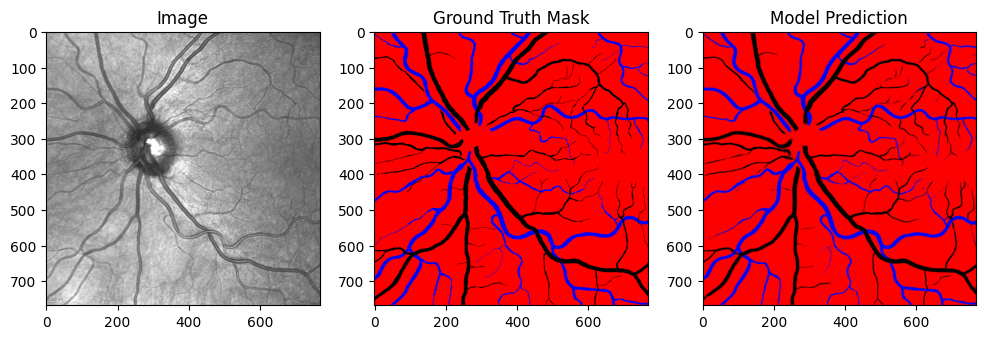

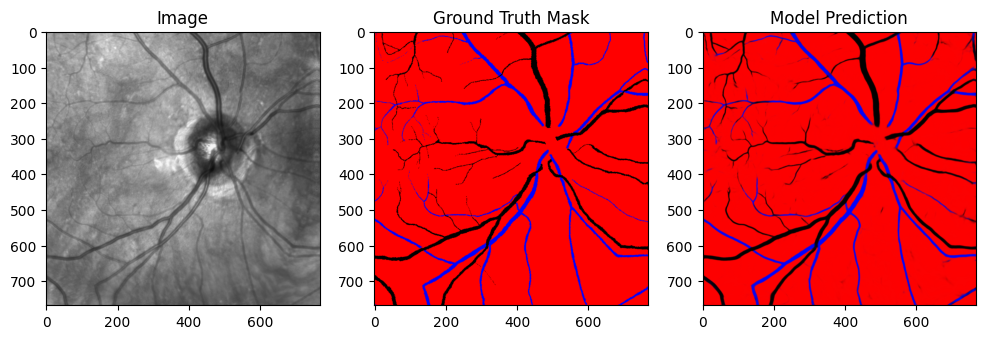

100%|██████████| 3/3 [00:01<00:00,  2.80it/s]


Validation Loss
IOU Loss: 0.03838491439819336 DICE Loss: 0.020365040749311447
Validation Loss: 0.07233363886674245


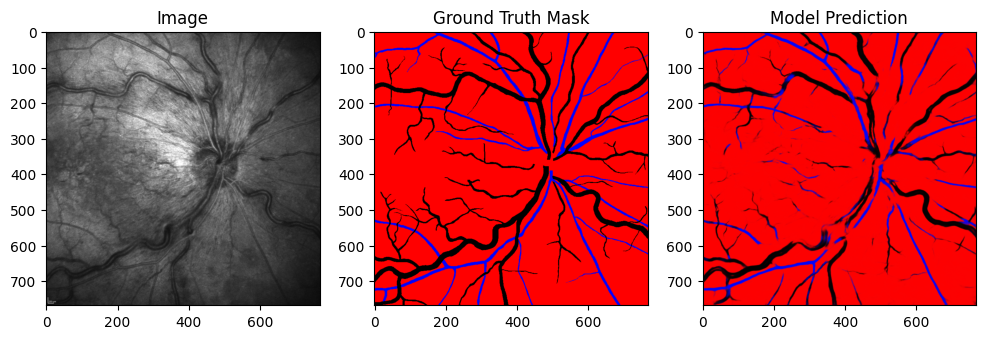

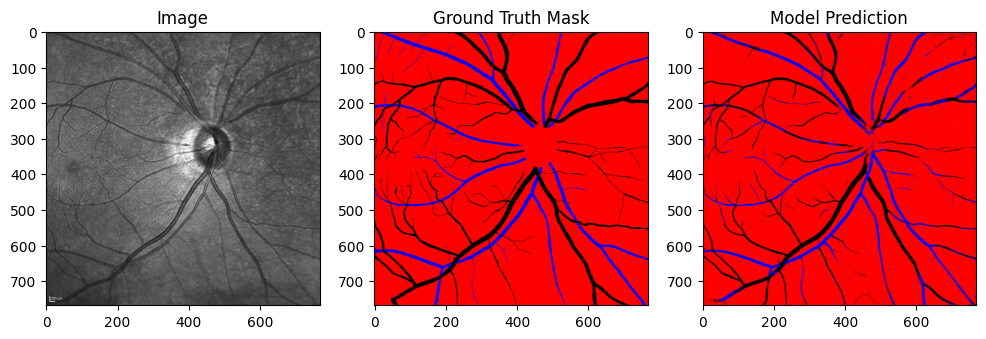

100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0029086514841765165,IOU: 0.23021168917221949 , DICE Loss: 0.0015137658920139074, MAPE Loss: 0.0011817722115665674
Epoch 142/150, Loss: 0.03991865221824911


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.003631176892668009,IOU: 0.23021181494518927 , DICE Loss: 0.0019091786816716194, MAPE Loss: 0.0016169643495231867
Epoch 143/150, Loss: 0.04245891560007025


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0026999865658581257,IOU: 0.23021191476970063 , DICE Loss: 0.0014010623563081026, MAPE Loss: 0.0010340033331885934
Epoch 144/150, Loss: 0.04229314804629043


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0032337706070393324,IOU: 0.23021184656227303 , DICE Loss: 0.001690694596618414, MAPE Loss: 0.0015180731425061822
Epoch 145/150, Loss: 0.039291290635312046


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0032884632237255573,IOU: 0.23021204993626723 , DICE Loss: 0.0017206183401867747, MAPE Loss: 0.0015916898846626282
Epoch 146/150, Loss: 0.038060840909127834


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]


Train Results
IOU Loss: 0.0030190127436071634,IOU: 0.23021230968199832 , DICE Loss: 0.001573644345626235, MAPE Loss: 0.0012268387945368886
Epoch 147/150, Loss: 0.03854638172520532


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Train Results
IOU Loss: 0.0024820147082209587,IOU: 0.23021226889840898 , DICE Loss: 0.001284032012335956, MAPE Loss: 0.0011665747733786702
Epoch 148/150, Loss: 0.038765812292695045


100%|██████████| 27/27 [00:44<00:00,  1.66s/it]


Train Results
IOU Loss: 0.0035769918467849493,IOU: 0.2302125310631359 , DICE Loss: 0.0018792439950630069, MAPE Loss: 0.001715848222374916
Epoch 149/150, Loss: 0.03955487582694601


100%|██████████| 27/27 [00:44<00:00,  1.65s/it]

Train Results
IOU Loss: 0.002618864644318819,IOU: 0.23021269623998133 , DICE Loss: 0.0013574229087680578, MAPE Loss: 0.0011854157783091068
Epoch 150/150, Loss: 0.039717146229964716


In [26]:
model.to(device)
trainLoss = []
valLoss = []

# Training loop
for epoch in range(epoch_num):
    model.train()
    running_loss = 0.0

    for inputs, masks in tqdm(trainDataLoader):
        inputs = inputs.to(device)
        masks = masks.to(device)
        optimizer.zero_grad()

        outputs= model(inputs)
        # print(torch.isnan(outputs).any())
        # print(torch.isinf(outputs).any())
        diceLoss = dice(outputs, masks)
        iouLoss = iou(outputs, masks)
        mapeLoss = mape(outputs, masks)
        loss = (0.85*criterion(outputs, masks))+(0.15*diceLoss)
        running_loss += loss.item()
        loss.backward()
        optimizer.step()
        mIoU.update(tensor_to_numpy(outputs), tensor_to_numpy(masks))
        torch.cuda.empty_cache()
        gc.collect()

    # Print average training loss for the epoch
    print("Train Results")
    print(f'IOU Loss: {iouLoss / len(trainDataLoader)},IOU: {mIoU.calculate()} , DICE Loss: {diceLoss / len(trainDataLoader)}, MAPE Loss: {mapeLoss / len(trainDataLoader)}')
    print(f'Epoch {epoch + 1}/{epoch_num}, Loss: {running_loss / len(trainDataLoader)}')
    trainLoss.append(running_loss / len(trainDataLoader))

    if epoch % 10 == 0:
      # Visualize a few samples
      with torch.no_grad():
          sample_indices = np.random.choice(len(trainDataLoader), 1)  # Adjust the number of samples to visualize
          sample_inputs, sample_masks = next(iter(trainDataLoader))
          sample_inputs = sample_inputs.to(device)
          sample_masks = sample_masks.to(device)

          sample_outputs = model(sample_inputs)


          plot_images(sample_inputs, sample_masks, sample_outputs)

      torch.cuda.empty_cache()
      gc.collect()

      model.eval()
      with torch.no_grad():
          validation_loss = 0.0
          for inputs, masks in tqdm(testDataLoader):
              inputs = inputs.to(device)
              masks = masks.to(device)
      #         print(masks.shape)

              outputs = model(inputs)
      #         print(outputs.shape)
              diceLoss = dice(outputs, masks)
              iouLoss = iou(outputs, masks)
              loss = (0.85*criterion(outputs, masks))+(0.15*diceLoss)

              validation_loss += loss.item()

          # Print average validation loss
          print("Validation Loss")
          print(f'IOU Loss: {iouLoss / len(testDataLoader)} DICE Loss: {diceLoss / len(testDataLoader)}')
          print(f'Validation Loss: {validation_loss / len(testDataLoader)}')


          sample_indices = np.random.choice(len(testDataLoader), 1)  # Adjust the number of samples to visualize
          sample_inputs, sample_masks = next(iter(testDataLoader))
          sample_inputs = sample_inputs.to(device)
          sample_masks = sample_masks.to(device)

          sample_outputs = model(sample_inputs)


          plot_images(sample_inputs, sample_masks, sample_outputs)
          valLoss.append(validation_loss / len(testDataLoader))
# Save the trained model if needed
torch.save(model.state_dict(), 'segmentation_model_light02.pth')


In [27]:
torch.cuda.empty_cache()
gc.collect()

0

In [28]:
def calculate_miou(model, val_loader, device, n_classes=3):
    model.eval()
    class_iou = torch.zeros(n_classes,  device=device)  # To store IoU for each class
    class_counts = torch.zeros(n_classes,  device=device)  # To count the number of instances for each class

    with torch.no_grad():
        for images, masks in tqdm(val_loader, desc="Calculating mIoU", leave=False):
            images = images.to(device)
            masks = masks.to(device).squeeze(1)  # Squeeze the masks
            outputs = model(images)
            outputs = torch.argmax(outputs, dim=1)  # Convert to predicted class indices

            # Calculate IoU for each class
            for class_idx in range(n_classes):
                true_class = masks == class_idx
                pred_class = outputs == class_idx
                intersection = torch.logical_and(true_class, pred_class).sum(dim=[1, 2])
                union = torch.logical_or(true_class, pred_class).sum(dim=[1, 2])
                iou = intersection / (union + 1e-6)  # Add a small value to avoid division by zero
                valid = union > 0  # Only consider this class if it's present in ground truth or prediction

                class_iou[class_idx] += iou[valid].sum()
                class_counts[class_idx] += valid.sum()

    # Calculate mean IoU
    mIoU = (class_iou / (class_counts + 1e-6)).mean()  # Average over all classes
    return mIoU.item()

In [29]:
def calculate_miou(model, val_loader, device, n_classes=3):
    model.eval()
    class_iou = torch.zeros(n_classes, device=device)  # To store IoU for each class
    class_counts = torch.zeros(n_classes, device=device)  # To count the number of instances for each class

    with torch.no_grad():
        for images, masks in tqdm(val_loader, desc="Calculating mIoU", leave=False):
            images = images.to(device)
            masks = masks.to(device)  # Assuming masks have three channels
            outputs = model(images)
            outputs = torch.argmax(outputs, dim=1)  # Convert to predicted class indices

            # Calculate IoU for each class
            for class_idx in range(n_classes):
                true_class = masks[:, class_idx, :, :]
                pred_class = outputs == class_idx
                intersection = torch.logical_and(true_class, pred_class).sum(dim=[1, 2])
                union = torch.logical_or(true_class, pred_class).sum(dim=[1, 2])
                iou = intersection / (union + 1e-6)  # Add a small value to avoid division by zero
                valid = union > 0  # Only consider this class if it's present in ground truth or prediction

                class_iou[class_idx] += iou[valid].sum()
                class_counts[class_idx] += valid.sum()

    # Calculate mean IoU
    class_iou[class_counts == 0] = 1.0  # Set IoU to 1.0 for classes with no instances in both GT and prediction
    mIoU = (class_iou / (class_counts + 1e-6)).mean()  # Average over all classes
    return mIoU.item()


In [30]:
miou = calculate_miou(model, testDataLoader, device)
miou

0.4627957046031952

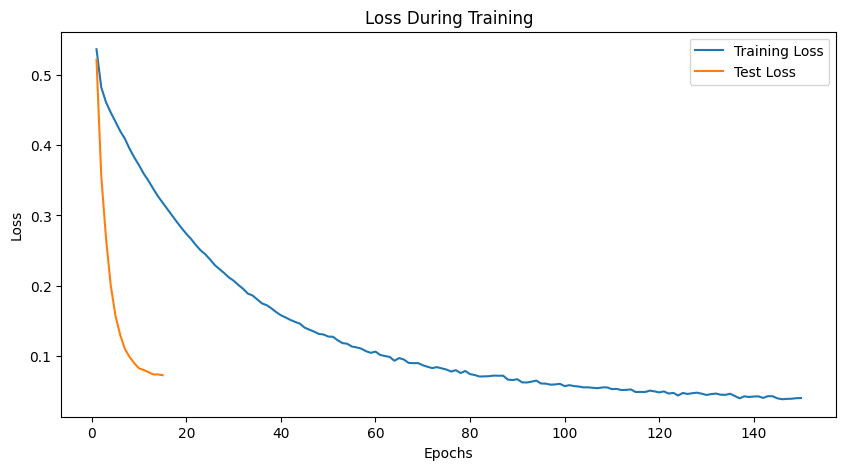

In [31]:
plt.figure(figsize=(10, 5))
plt.plot(np.arange(1,len(trainLoss)+1),trainLoss, label='Training Loss')
plt.plot(np.arange(1,len(valLoss)+1),valLoss, label='Test Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss During Training')
plt.legend()
plt.show()


Text(0.5, 1.0, 'Loss During Training')

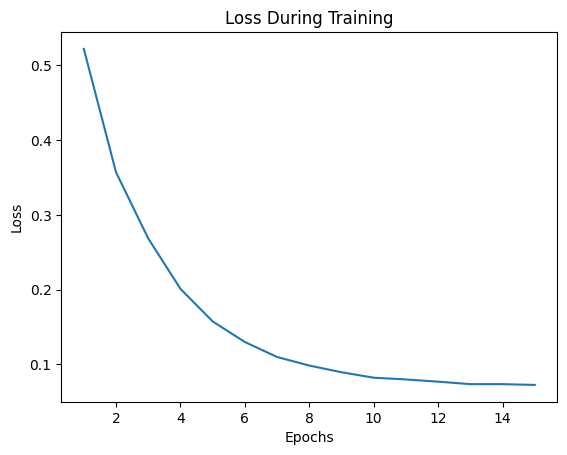

In [32]:
plt.plot(np.arange(1,len(valLoss)+1),valLoss, label='Test Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss During Training')